In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# **Prime Librerie da importare**

In [ ]:
import cv2
import numpy as np
import dlib
import math
import os
from pathlib import Path

In [ ]:
path_principale = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/"
path_train = "Train/"
path_test = "Test/"
path_validation = "Validation/"

# **Salvataggio lista di librerie e versioni installate**

In [ ]:
!pip freeze > "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/requirements_estrazioneFeatures.txt"

# **Creazioni directory importanti per il progetto**

In [ ]:
# Funzione per creare una directory se non esiste già
def create_directory_if_not_exists(directory):
    if not os.path.exists(directory):
        os.makedirs(directory)

# Creazione delle directory principali
create_directory_if_not_exists(path_principale + "CSV_DATASET")
create_directory_if_not_exists(path_principale + "CSV_DATASET_MERGED")
create_directory_if_not_exists(path_principale + "CSV_DATASET_SVD")
create_directory_if_not_exists(path_principale + "CSV_PNN_RESULT")
create_directory_if_not_exists(path_principale + "CSV_PNN_RESULT_MERGED")
create_directory_if_not_exists(path_principale + "CSV_PNN_RESULT_SVD")
create_directory_if_not_exists(path_principale + "CSV_DATASET_CH-SIMS_CMU-MOSEI")
create_directory_if_not_exists(path_principale + "FILE_PATH")

# Creazione delle sotto-directory per train, test e validation
create_directory_if_not_exists(path_principale + "CSV_DATASET/" + path_train)
create_directory_if_not_exists(path_principale + "CSV_DATASET/" + path_test)
create_directory_if_not_exists(path_principale + "CSV_DATASET/" + path_validation)

create_directory_if_not_exists(path_principale + "CSV_DATASET_MERGED/" + path_train)
create_directory_if_not_exists(path_principale + "CSV_DATASET_MERGED/" + path_test)
create_directory_if_not_exists(path_principale + "CSV_DATASET_MERGED/" + path_validation)

create_directory_if_not_exists(path_principale + "CSV_DATASET_SVD/" + path_train)
create_directory_if_not_exists(path_principale + "CSV_DATASET_SVD/" + path_test)
create_directory_if_not_exists(path_principale + "CSV_DATASET_SVD/" + path_validation)

create_directory_if_not_exists(path_principale + "CSV_PNN_RESULT/" + path_train)
create_directory_if_not_exists(path_principale + "CSV_PNN_RESULT/" + path_test)
create_directory_if_not_exists(path_principale + "CSV_PNN_RESULT/" + path_validation)

create_directory_if_not_exists(path_principale + "CSV_PNN_RESULT_MERGED/" + path_train)
create_directory_if_not_exists(path_principale + "CSV_PNN_RESULT_MERGED/" + path_test)
create_directory_if_not_exists(path_principale + "CSV_PNN_RESULT_MERGED/" + path_validation)

create_directory_if_not_exists(path_principale + "CSV_PNN_RESULT_SVD/" + path_train)
create_directory_if_not_exists(path_principale + "CSV_PNN_RESULT_SVD/" + path_test)
create_directory_if_not_exists(path_principale + "CSV_PNN_RESULT_SVD/" + path_validation)

create_directory_if_not_exists(path_principale + "CSV_DATASET_CH-SIMS_CMU-MOSEI/" + path_train)
create_directory_if_not_exists(path_principale + "CSV_DATASET_CH-SIMS_CMU-MOSEI/" + path_test)

create_directory_if_not_exists(path_principale + "CSV_DATASET_OPTICAL_FLOW/" + path_train)
create_directory_if_not_exists(path_principale + "CSV_DATASET_OPTICAL_FLOW/" + path_test)
create_directory_if_not_exists(path_principale + "CSV_DATASET_OPTICAL_FLOW/" + path_validation)

create_directory_if_not_exists(path_principale + "CSV_DATASET_OPTICAL_FLOW/" + path_train + "TWO_FRAME/")
create_directory_if_not_exists(path_principale + "CSV_DATASET_OPTICAL_FLOW/" + path_test + "TWO_FRAME/")
create_directory_if_not_exists(path_principale + "CSV_DATASET_OPTICAL_FLOW/" + path_validation + "TWO_FRAME/")

create_directory_if_not_exists(path_principale + "CSV_DATASET_OPTICAL_FLOW/" + path_train + "SEQUENCE/")
create_directory_if_not_exists(path_principale + "CSV_DATASET_OPTICAL_FLOW/" + path_test + "SEQUENCE/")
create_directory_if_not_exists(path_principale + "CSV_DATASET_OPTICAL_FLOW/" + path_validation + "SEQUENCE/")

create_directory_if_not_exists(path_principale + "FILE_PATH/" + path_train)
create_directory_if_not_exists(path_principale + "FILE_PATH/" + path_test)
create_directory_if_not_exists(path_principale + "FILE_PATH/" + path_validation)

# **Configurazione mediapipe**

## Installazione mediapipe

In [ ]:
!pip install mediapipe

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 33.9/33.9 MB 38.3 MB/s eta 0:00:00


## Coordinate dei landmark delle labbra di mediapipe

In [ ]:
FACEMESH_LIPS = [(306,402),(61,402), (17, 314), (0, 267),(37,402),(267,402),(84,402),(314,402),(61,402),(17, 314)]

# **Funzioni per il calcolo dei landmark**

## **Funzione che calcola la distanza tra due landmark sfruttando la distanza cityblock**

In [ ]:
from scipy.spatial import distance

def calcola_distanza_landmark(selected_points):
  if any(math.isnan(val) for coord in selected_points for val in coord):
        return math.nan
  # Inizializzazione della variabile per la lunghezza totale
  total_length = 0

  # Iterazione su tutti i landmark selezionati in ordine
  for i in range(len(selected_points)-1):
      # Estrazione delle coordinate del landmark corrente
      p1= selected_points[i]
      
      # Estrazione delle coordinate del landmark successivo
      p2 = selected_points[i+1]
      # cityblock, cosine, chebyshev, euclidean
      distanza = distance.cityblock(p1, p2)
      
      
      # Aggiornamento della lunghezza totale
      total_length += distanza
      #total_length = round(total_length,2)
  
  return total_length

## **Funzione che estrae la larghezza delle labbra in pixel**

In [ ]:
# larghezza delle labbra su tre punti specifici
def estrazione_feature_larghezza(landmarks_points):

  zona_superiore = [landmarks_points[37],  landmarks_points[267]]

  zona_centrale =  [landmarks_points[61],  landmarks_points[306] ]

  zona_inferiore = [landmarks_points[84],  landmarks_points[314]]

  w1 = calcola_distanza_landmark(zona_superiore)
  w2 = calcola_distanza_landmark(zona_centrale)
  w3 = calcola_distanza_landmark(zona_inferiore)

  return {"37-267":w1, "61-306": w2,"84-314": w3}
  '''
  values =[w1,w2,w3]
 
  if np.isnan(values).any():
    media = math.nan
  else:
    media =  (w1 + w2 + w3)/ 3

  return {"f2":media}  '''

## **Funzione che estrae l'altezza delle labbra in pixel**

In [ ]:
# Altezza delle labbra utilizzando i tubercoli
def estrazione_feature_altezza(landmarks_points):

  tubercolo_sinistro_superiore = [landmarks_points[37],  landmarks_points[84]]

  tubercolo_centrale_superiore = [landmarks_points[0],  landmarks_points[17]]

  tubercolo_destro_superiore = [landmarks_points[267],  landmarks_points[314]]

  h1 = calcola_distanza_landmark(tubercolo_sinistro_superiore)
  h2 = calcola_distanza_landmark(tubercolo_centrale_superiore)
  h3 = calcola_distanza_landmark(tubercolo_destro_superiore)


  return {"37-84":h1,"0-17": h2,"267-314":h3}
'''
  values =[h1,h2,h3]
 
  if np.isnan(values).any():
    media = math.nan
  else:
    media =  (h1 + h2 + h3)/ 3

  return {"f3":media}   '''

## **Funzione utilizzata per settare i valori dei landmark a (0,0) in caso che il volto non venga rilevato**

In [ ]:
# funzione che controlla se un landmark è stato trovato, se non è stato trovato setta il suo valore a NaN
def key_exists(landmarks_points):
  temp_value = [math.nan, math.nan]
  if 37 not in landmarks_points:
    landmarks_points[37] = temp_value
  if 267 not in landmarks_points:
    landmarks_points[267] = temp_value
  if 61 not in landmarks_points:
    landmarks_points[61] = temp_value
  if 306 not in landmarks_points:
    landmarks_points[306] = temp_value
  if 84 not in landmarks_points:
    landmarks_points[84] = temp_value
  if 314 not in landmarks_points:
    landmarks_points[314] = temp_value
  if 0 not in landmarks_points:
    landmarks_points[0] = temp_value
  if 17 not in landmarks_points:
    landmarks_points[17] = temp_value

## **Funzione che genera un dizionario contenente le feature delle labbra**

In [ ]:
def generaFeature(landmarks_points):
  key_exists(landmarks_points)
  feature2 = estrazione_feature_larghezza(landmarks_points)
  feature3 = estrazione_feature_altezza(landmarks_points)

  return dict(feature2,  **feature3)

# **Funzione per toglierre i NaN**


In [ ]:
import pandas as pd


# Funzione che riempie i valori NaN con la media mobile calcolata su una finestra mobile di lunghezza n_frame
# Il tutto a condizione che ci siano almeno 2 valori non NaN nella finestra (min_periods)
def fill_nan(row, n_frame):
    return row.fillna(row.rolling(min_periods=2, window=n_frame).mean())

# Funzione per sostituire i valori NaN all'inizio del file
def remove_initial_nan(df):
  # Sostituzione dei valori NaN nelle colonne intermedie con la media dei successivi
  df_filled = df.copy()
  columns_to_fill = df.columns[1:-1]  # Seleziona tutte le colonne tranne la prima e l'ultima

  for column in columns_to_fill:
      df_filled[column].fillna(df_filled[column].fillna(method='ffill').shift(-1).mean(), inplace=True)
    
  return df_filled

# Funzione per rimuovere i valori NaN
def remove_nan(df,num_frames_per_second):
  df = remove_initial_nan(df)
  df = df.apply(fill_nan, axis=1, n_frame=num_frames_per_second) #Caso di NaN in altre posizioni

  return df

# Funzione per estrarre componente verticale e orizzontale dal flusso


Spiegazione paramaetri della funzione:
* prev_frame: È il frame precedente (o l'immagine precedente) dalla sequenza di input. Deve essere un'immagine in scala di grigi (un singolo canale).

* next_frame_gray: È il frame successivo (o l'immagine successiva) dalla sequenza di input. Anch'esso deve essere un'immagine in scala di grigi.

* prev_flow: Questo parametro può essere utilizzato per fornire un'ipotesi iniziale del flusso ottico. Se non si dispone di una stima iniziale, si può passare None.

* pyr_scale: È un parametro che specifica la scala dell'immagine per la piramide a livelli multipli. Di solito è impostato a 0.5, il che significa che ogni livello della piramide successivo è la metà delle dimensioni del livello precedente.

* levels: Rappresenta il numero di livelli nella piramide a livelli multipli utilizzata per il calcolo. Un numero tipico di livelli è 3.

* winsize: Specifica la dimensione della finestra di media mobile utilizzata per approssimare la derivata spaziale. Un valore comune è 15.

* iterations: Rappresenta il numero di iterazioni dell'algoritmo di ottimizzazione per ogni livello della piramide. Di solito si usa 3.

* poly_n: È il grado del polinomio espanso per approssimare la distribuzione dei pixel circostanti. Un valore tipico è 5.

* poly_sigma: Specifica la deviazione standard del kernel gaussiano usato per approssimare le derivate spaziali. Un valore comune è 1.2.

* flags: Sono dei flag opzionali che possono essere utilizzati per modificare il comportamento dell'algoritmo. In questo caso, il valore 0 indica l'uso delle impostazioni predefinite.

* flow: Questo è il parametro di output in cui verrà restituito il flusso ottico calcolato dall'algoritmo.

## Definizione parametri del flusso ottico

In [ ]:
prev_flow=None
pyr_scale = 0.5
levels = 3
winsize = 15
iterations = 3
poly_n = 5
poly_sigma = 1.2
flags = 0

## Estrazione componente verticale e orizzontale tra due frame consecutivi

In [ ]:
def calcola_feature_flusso_ottico_tra_due_frame(prev_frame, next_frame_gray, prev_flow=None ):

  flusso = cv2.calcOpticalFlowFarneback(prev_frame, next_frame_gray,prev_flow, pyr_scale,
                                      levels, winsize,iterations, poly_n, poly_sigma, flags)


  # Estrai le componenti orizzontali e verticali del flusso ottico 
  # (se un valore è negativo vuol dire che la direzione della labbra dal frame precedente è cambiata
  flusso_orizzontale = flusso[:, :, 0]  # Componente orizzontale del flusso ottico
  flusso_verticale = flusso[:, :, 1]  # Componente verticale del flusso ottico

  # Calcola le medie delle componenti orizzontali e verticali
  media_orizzontale = np.mean(flusso_orizzontale)
  media_verticale = np.mean(flusso_verticale)

  #print("Media della componente orizzontale:", mean_horizontal)
  #print("Media della componente verticale:", mean_vertical)

  return {'media_orizzontale':media_orizzontale,'media_verticale':media_verticale }

In [ ]:
def calcola_flusso_ottico_sequenza(sequence, prev_flow=None):
    # Converti il primo frame in scala di grigi
    prev_frame_gray = sequence[0]
    # Inizializza il flusso ottico accumulato
    flusso_accumulato = None

    # Itera attraverso la sequenza a partire dal secondo frame
    for i in range(1, len(sequence)):
        # Converti il frame corrente in scala di grigi
        next_frame_gray = sequence[i]

        # Calcola il flusso ottico tra il frame precedente e il frame corrente
        flusso = cv2.calcOpticalFlowFarneback(prev_frame, next_frame_gray,prev_flow, pyr_scale,
                                      levels, winsize,iterations, poly_n, poly_sigma, flags)

        # Accumula il flusso ottico
        if flusso_accumulato is None:
            flusso_accumulato = flusso
        else:
            flusso_accumulato += flusso

        # Imposta il frame corrente come frame precedente per la prossima iterazione
        prev_frame_gray = next_frame_gray

    # Estrai le componenti orizzontali e verticali del flusso ottico
    flusso_orizzontale = flusso_accumulato[:, :, 0]  # Componente orizzontale del flusso ottico
    flusso_verticale = flusso_accumulato[:, :, 1]  # Componente verticale del flusso ottico

    # Calcola la media delle componenti orizzontali e verticali
    media_orizzontale = np.mean(flusso_orizzontale)
    media_verticale = np.mean(flusso_verticale)

    return {'media_orizzontale':media_orizzontale,'media_verticale':media_verticale }

# **Generazione dei file in cui saranno contenute le path dei video**

## Creazione file path video Babele

La nomenclatura proposta è stata:
*Language_gender_age_id-unique_framerate*

In merito a questo il csv in output sarà così formato:
*   Nome del file: *Language_gender_age_id-unique_framerate_numeroframe*
*   Features estratte: distanza labbra , ecc
*   Target: lingua associata al frame con le feature estratte


 

In [ ]:
import os
import glob

# cartella contenente la path del dataset
dataset_path = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Datasets/Dataset_2_BABELE/BABELE_Dataset/Dataset_split_subject_independent/Full_video_10_seconds_division_train_test_val"

# cartella in cui salvare i file
folder_save = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/FILE_PATH"

# Loop over all subfolders in folder_read
for subfolder in os.listdir(dataset_path):
    # Create a file with the subfolder's name in folder_save
    file_path = os.path.join(folder_save, subfolder + "_babele.txt")
    
    # Open the file for writing
    with open(file_path, "w") as f:
        # Get a list of all files in the subfolder
        files = glob.glob(os.path.join(dataset_path, subfolder, "*"))
        
        # Write each file's path to the file
        for file in files:
            f.write(file + "\n")


## Creazione file path video CH-SIMS

In [ ]:
import os

# Cartella contenente la path del dataset
dataset_path = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Datasets/Dataset_1_CH-SIMS_CMU-MOSEI/CH-SIMS/Originali/Versione_sperimentazione_6_video_+_lunghi_per_soggetto-originali"

# Cartella in cui salvare i file
folder_save = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/FILE_PATH"


# Crea un file con il nome della directory in folder_save
file_path = os.path.join(folder_save, "dataset_cinese.txt")

# Apre il file in modalità scrittura
with open(file_path, "w") as f:
  # Esplora ricorsivamente solo i file di livello più basso nella directory
  for root, dirs, files in os.walk(dataset_path, topdown=False):
    for file in files:
      file_path = os.path.join(root, file)
      f.write(file_path + "\n")


## Creazione file path video CMU-MOSEI

In [ ]:
import os

# Cartella contenente la path del dataset
dataset_path = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Datasets/Dataset_1_CH-SIMS_CMU-MOSEI/CMU-MOSEI/Originali/Versione_sperimentazione_6_video_+_lunghi_per_35_soggetti-originali"

# Cartella in cui salvare i file
folder_save = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/FILE_PATH"


# Crea un file con il nome della directory in folder_save
file_path = os.path.join(folder_save, "dataset_inglese.txt")

# Apre il file in modalità scrittura
with open(file_path, "w") as f:
  # Esplora ricorsivamente solo i file di livello più basso nella directory
  for root, dirs, files in os.walk(dataset_path, topdown=False):
    for file in files:
      file_path = os.path.join(root, file)
      f.write(file_path + "\n")

## Creazione file path video Babele per optical flow

In [ ]:
import os
import glob

# cartella contenente la path del dataset
dataset_path = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Datasets/Dataset_2_BABELE/BABELE_Dataset/Dataset_split_subject_independent/Lips_video_10_seconds_division_train_test_val"

# cartella in cui salvare i file
folder_save = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/FILE_PATH"

# Loop over all subfolders in folder_read
for subfolder in os.listdir(dataset_path):
    # Create a file with the subfolder's name in folder_save
    file_path = os.path.join(folder_save, subfolder + "_babele.txt")
    
    # Open the file for writing
    with open(file_path, "w") as f:
        # Get a list of all files in the subfolder
        files = glob.glob(os.path.join(dataset_path, subfolder, "*"))
        
        # Write each file's path to the file
        for file in files:
            f.write(file + "\n")

# **Preprocessing dei file**

*   Estrazione dei landmark dai frame video
*   Calcolo distanze fra i landmark
*   Creazione di un file csv per ogni file di testo che contiene le path dei video




## Lista contenente le path dei file dei video

In [ ]:
files_path = ["/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/FILE_PATH/Test_babele.txt",
              "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/FILE_PATH/Validation_babele.txt",
              "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/FILE_PATH/Train_babele.txt"
              ]

## **Generazione dataset contenente le feature, con i frame scelti in modo sequenziale**

In [ ]:
import cv2
import mediapipe as mp
import pandas as pd
import os
from tqdm import tqdm

# Caricamento del modello di rilevamento dei landmarks del volto
mp_drawing = mp.solutions.drawing_utils
mp_face_mesh = mp.solutions.face_mesh

# Inizializza il rilevatore dei landmark del viso
face_mesh = mp_face_mesh.FaceMesh()


for path_file in files_path:

  with open(path_file, mode='r') as file:

    video_data = []  # Lista di tutti i dati dei video
    
    linee = file.readlines()

    csv_filename = os.path.basename(path_file)
    csv_filename_without_extension = csv_filename.split(".")[0] #per la creazione del dataset voglio un nome senza .txt
    estensione = "_cityblock_100FPS.csv"

    if "Validation" in path_file:
      csv_path = path_principale+"CSV_DATASET/"+path_validation + csv_filename_without_extension + estensione
    elif "Train" in path_file:
      csv_path = path_principale+"CSV_DATASET/"+path_train + csv_filename_without_extension + estensione
    elif "Test" in path_file:
       csv_path = path_principale+"CSV_DATASET/"+path_test + csv_filename_without_extension + estensione
    else:
      print("Qualcosa è andato storto!")
      break
    
    for video_path in tqdm(linee, desc="Elaborazione video " + csv_filename_without_extension, unit="video"):
        video_path = video_path.strip() # Rimuovi il carattere di a capo dalla stringa

        # Apre il video in input
        cap = cv2.VideoCapture(str(video_path))

        filename = os.path.basename(video_path) #Nome del file video
        filename_without_extension = filename.split(".")[0] #per la creazione del dataset voglio un nome senza .avi
        components = filename.split("_")[:-1] #splitto l'array in un altro per "_" e elimino ".avi"
       
        target = int(components[0]) #Estrazione classe (lingua)
        
        # Inizializza la lista dei dati del video
        video_data_video = []

        # Loop attraverso tutti i frame del video
        frame_count = 0
        frame_data = {}
        #nome del frame
        frame_data['video-frame'] = filename_without_extension # Alla fine collego al nome del file il frame analizzato
        colonna = 0
       
        while cap.isOpened() and frame_count < 240:
            
            
            ret, frame = cap.read()
            if not ret:
                break

            # Salta il frame se necessario
            if  frame_count % 2 != 0:
                frame_count += 1
                continue
          
            # Converte l'immagine in RGB
            frame_RGB = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            
            if frame_RGB is None:
              print("Frame errato, la funzione cv2.COLOR_BGR2RGB non è stata in grado di convertire l'immagine in RGB")
              frame_count += 1
              continue
            else:
              results = face_mesh.process(frame_RGB)

              if results is None:
                print("Qualcosa è andato storto!")
                frame_count += 1
                continue
              else:
                # Memorizza i punti dei landmarks delle labbra
                landmarks_points = {}
                if results.multi_face_landmarks:
                    face_landmarks = results.multi_face_landmarks[0]
                    for connection in FACEMESH_LIPS:
                        landmark_1 = face_landmarks.landmark[connection[0]]
                        n = connection[0]

                        # Salva i dati del landmark
                        landmarks_points[n] = [landmark_1.x, landmark_1.y]

                
                feature = generaFeature(landmarks_points)

                video_data_video
                
                # Crea il dizionario con i dati del frame
                frame_data['37-267_'+str(colonna)] = feature['37-267']
                frame_data['61-306_'+str(colonna)]= feature['61-306']
                frame_data['84-314_'+str(colonna)]= feature['84-314']
                frame_data['37-84_'+str(colonna)]= feature['37-84']
                frame_data['0-17_'+str(colonna)]= feature['0-17']
                frame_data['267-314_'+str(colonna)]= feature['267-314']

                frame_count += 1
                colonna += 1 

        frame_data['target']=  target
        
        # Aggiungi il dizionario alla lista dei dati del video
        video_data_video.append(frame_data)

        # Aggiungi i dati del video alla lista di tutti i dati
        video_data.extend(video_data_video)

        # Chiudi il video
        cap.release()

    # Crea il dataframe dai dati di tutti i video e visualizzalo
    df = pd.DataFrame(video_data)

    # Check per valori NaN
    df = remove_nan(df,60)

    # Visualizza il DataFrame
    display(df)

    print(100*"-")
    print("Generazione del file csv ", csv_filename_without_extension, estensione)
    print(100*"-")
    df.to_csv(csv_path, index=False)

    file.close()

# Chiudi il rilevatore dei landmark del viso
face_mesh.close()

## **Generazione dataset contenente le feature,con scelta randomica dei frame**


In [ ]:
import cv2
import mediapipe as mp
import pandas as pd
import os
from tqdm import tqdm
import random

# Caricamento del modello di rilevamento dei landmarks del volto
mp_drawing = mp.solutions.drawing_utils
mp_face_mesh = mp.solutions.face_mesh

# Inizializza il rilevatore dei landmark del viso
face_mesh = mp_face_mesh.FaceMesh()


for path_file in files_path:

  with open(path_file, mode='r') as file:

    video_data = []  # Lista di tutti i dati dei video
    
    linee = file.readlines()

    num_frames = 60

    csv_filename = os.path.basename(path_file)
    csv_filename_without_extension = csv_filename.split(".")[0] #per la creazione del dataset voglio un nome senza .txt
    estensione = "_cityblock_10_random.csv"

    if "Validation" in path_file:
      csv_path = path_principale+"CSV_DATASET/"+path_validation + csv_filename_without_extension + estensione
    elif "Train" in path_file:
      csv_path = path_principale+"CSV_DATASET/"+path_train + csv_filename_without_extension + estensione
    elif "Test" in path_file:
       csv_path = path_principale+"CSV_DATASET/"+path_test + csv_filename_without_extension + estensione
    else:
      print("Qualcosa è andato storto!")
      break
    
    for video_path in tqdm(linee, desc="Elaborazione video " + csv_filename_without_extension, unit="video"):
        video_path = video_path.strip() # Rimuovi il carattere di a capo dalla stringa

        # Apre il video in input
        cap = cv2.VideoCapture(str(video_path))

        filename = os.path.basename(video_path) #Nome del file video
        filename_without_extension = filename.split(".")[0] #per la creazione del dataset voglio un nome senza .avi
        components = filename.split("_")[:-1] #splitto l'array in un altro per "_" e elimino ".avi"
       
        target = int(components[0]) #Estrazione classe (lingua)

        # Inizializza la lista dei dati del video
        video_data_video = []

        # Loop attraverso tutti i frame del video
        frame_count = 0
        frame_data = {}
        #nome del frame
        frame_data['video-frame'] = filename_without_extension # Alla fine collego al nome del file il frame analizzato
        colonna = 0

        # Genero un array di tot numeri casuali da 0 a 239
        random_indices = random.sample(range(240), 10)
       
        while cap.isOpened() and frame_count < 240:
            
            ret, frame = cap.read()
            if not ret:
                break

            if frame_count not in random_indices: #l'indice del frame non si trova in quelli random
              frame_count += 1
              continue
            
            # Converte l'immagine in RGB
            frame_RGB = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            
            if frame_RGB is None:
              print("Frame errato, la funzione cv2.COLOR_BGR2RGB non è stata in grado di convertire l'immagine in RGB")
              frame_count += 1
              continue
            else:
              results = face_mesh.process(frame_RGB)

              if results is None:
                print("Qualcosa è andato storto!")
                frame_count += 1
                continue
              else:
                # Memorizza i punti dei landmarks delle labbra
                landmarks_points = {}
                if results.multi_face_landmarks:
                    face_landmarks = results.multi_face_landmarks[0]
                    for connection in FACEMESH_LIPS:
                        landmark_1 = face_landmarks.landmark[connection[0]]
                        n = connection[0]

                        # Salva i dati del landmark
                        landmarks_points[n] = [landmark_1.x, landmark_1.y]

                
                feature = generaFeature(landmarks_points)

                video_data_video
                
                # Crea il dizionario con i dati del frame
                frame_data['37-267_'+str(colonna)] = feature['37-267']
                frame_data['61-306_'+str(colonna)]= feature['61-306']
                frame_data['84-314_'+str(colonna)]= feature['84-314']
                frame_data['37-84_'+str(colonna)]= feature['37-84']
                frame_data['0-17_'+str(colonna)]= feature['0-17']
                frame_data['267-314_'+str(colonna)]= feature['267-314']

                frame_count += 1
                colonna += 1 

        frame_data['target']=  target
        
        # Aggiungi il dizionario alla lista dei dati del video
        video_data_video.append(frame_data)

        # Aggiungi i dati del video alla lista di tutti i dati
        video_data.extend(video_data_video)

        # Chiudi il video
        cap.release()

    # Crea il dataframe dai dati di tutti i video e visualizzalo
    df = pd.DataFrame(video_data)

    # Check per valori NaN
    df = remove_nan(df,num_frames)


    # Visualizza il DataFrame
    display(df)

    print(100*"-")
    print("Generazione del file csv ", csv_filename_without_extension, estensione)
    print(100*"-")
    df.to_csv(csv_path, index=False)

    file.close()

# Chiudi il rilevatore dei landmark del viso
face_mesh.close()

Elaborazione video Validation_babele: 100%|██████████| 160/160 [00:34<00:00,  4.64video/s]


,video-frame,37-267_0,61-306_0,84-314_0,37-84_0,0-17_0,267-314_0,37-267_1,61-306_1,84-314_1,...,37-84_8,0-17_8,267-314_8,37-267_9,61-306_9,84-314_9,37-84_9,0-17_9,267-314_9,target
0,2_1_1_11_25_1,0.015646,0.048743,0.014950,0.041426,0.041804,0.041273,0.011664,0.037777,0.011263,...,0.029984,0.029410,0.029898,0.012490,0.040471,0.012194,0.027890,0.027333,0.027900,2
1,2_1_1_11_25_2,0.013704,0.043118,0.013493,0.038130,0.038396,0.038310,0.013477,0.042278,0.013143,...,0.026440,0.026051,0.026725,0.012610,0.040627,0.012713,0.031612,0.031637,0.031868,2
2,2_1_1_11_25_3,0.011761,0.037493,0.012037,0.034833,0.034987,0.035346,0.012911,0.039166,0.013071,...,0.037121,0.037508,0.037112,0.012730,0.040783,0.013232,0.035334,0.035942,0.035836,2
3,2_1_1_11_25_4,0.011939,0.038345,0.011497,0.030148,0.030043,0.030378,0.012688,0.040190,0.012332,...,0.035396,0.035930,0.035052,0.012773,0.035649,0.013435,0.036573,0.036802,0.035755,2
4,2_1_1_11_25_5,0.012158,0.041246,0.011983,0.022261,0.021167,0.021971,0.012579,0.040941,0.012313,...,0.029414,0.028806,0.029326,0.015248,0.047845,0.016009,0.043010,0.043580,0.043815,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,8_1_2_1_25_5,0.015729,0.048705,0.015937,0.044988,0.044732,0.044394,0.015601,0.051785,0.014970,...,0.029130,0.028815,0.029532,0.015747,0.051776,0.015234,0.036507,0.036247,0.036512,8
156,8_1_2_1_25_4,0.014779,0.045321,0.016009,0.051286,0.051124,0.050252,0.014318,0.045466,0.014157,...,0.035714,0.035267,0.035444,0.014140,0.047416,0.013542,0.027214,0.026518,0.027218,8
157,8_1_2_1_25_3,0.016315,0.054161,0.015302,0.027930,0.027564,0.028746,0.019438,0.064148,0.018610,...,0.051884,0.051233,0.051996,0.030335,0.100658,0.031033,0.062495,0.061469,0.061858,8
158,8_1_2_1_25_2,0.027066,0.087198,0.026463,0.058292,0.057079,0.058366,0.028269,0.092328,0.026711,...,0.042038,0.041533,0.042147,0.016008,0.052762,0.016099,0.036587,0.036143,0.036498,8


----------------------------------------------------------------------------------------------------
Generazione del file csv  Validation_babele _cityblock_10_random.csv
----------------------------------------------------------------------------------------------------


## **Generazione dataset contenente le feature,scelta randomica dei frames ogni secondo**

In [ ]:
import random
import cv2
import mediapipe as mp
import pandas as pd
import os
from tqdm import tqdm

fps = 24
num_frames = 240
num_frames_per_second = 6
num_seconds = num_frames // fps

random_indices = []
for i in range(num_seconds):
    start_index = i * fps
    end_index = start_index + fps
    indices = list(range(start_index, end_index))
    random_indices.extend(random.sample(indices, num_frames_per_second))

random_indices.sort()

frames_to_process = [i for i in range(num_frames) if i in random_indices]

print(frames_to_process)



# Caricamento del modello di rilevamento dei landmarks del volto
mp_drawing = mp.solutions.drawing_utils
mp_face_mesh = mp.solutions.face_mesh

# Inizializza il rilevatore dei landmark del viso
face_mesh = mp_face_mesh.FaceMesh()


for path_file in files_path:

  with open(path_file, mode='r') as file:

    video_data = []  # Lista di tutti i dati dei video
    
    linee = file.readlines()

    csv_filename = os.path.basename(path_file)
    csv_filename_without_extension = csv_filename.split(".")[0] #per la creazione del dataset voglio un nome senza .txt
    estensione = "_cityblock_random6.csv"

    if "Validation" in path_file:
      csv_path = path_principale+"CSV_DATASET/"+path_validation + csv_filename_without_extension + estensione
    elif "Train" in path_file:
      csv_path = path_principale+"CSV_DATASET/"+path_train + csv_filename_without_extension + estensione
    elif "Test" in path_file:
       csv_path = path_principale+"CSV_DATASET/"+path_test + csv_filename_without_extension + estensione
    else:
      print("Qualcosa è andato storto!")
      break

    for video_path in tqdm(linee, desc="Elaborazione video " + csv_filename_without_extension, unit="video"):
        video_path = video_path.strip() # Rimuovi il carattere di a capo dalla stringa

        # Apre il video in input
        cap = cv2.VideoCapture(str(video_path))

        filename = os.path.basename(video_path) #Nome del file video
        filename_without_extension = filename.split(".")[0] #per la creazione del dataset voglio un nome senza .avi
        components = filename.split("_")[:-1] #splitto l'array in un altro per "_" e elimino ".avi"
       
        target = int(components[0]) #Estrazione classe (lingua)

        # Inizializza la lista dei dati del video
        video_data_video = []

        # Loop attraverso tutti i frame del video
        frame_count = 0
        frame_data = {}
        #nome del frame
        frame_data['video-frame'] = filename_without_extension # Alla fine collego al nome del file il frame analizzato
        colonna = 0

        while cap.isOpened() and frame_count < 240:
            
            ret, frame = cap.read()
            if not ret:
                break

            if frame_count not in frames_to_process: #l'indice del frame non si trova in quelli random
              frame_count += 1
              continue
          
            # Converte l'immagine in RGB
            frame_RGB = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            
            if frame_RGB is None:
              print("Frame errato, la funzione cv2.COLOR_BGR2RGB non è stata in grado di convertire l'immagine in RGB")
              frame_count += 1
              continue
            else:
              results = face_mesh.process(frame_RGB)

              if results is None:
                print("Qualcosa è andato storto!")
                frame_count += 1
                continue
              else:
                # Memorizza i punti dei landmarks delle labbra
                landmarks_points = {}
                if results.multi_face_landmarks:
                    face_landmarks = results.multi_face_landmarks[0]
                    for connection in FACEMESH_LIPS:
                        landmark_1 = face_landmarks.landmark[connection[0]]
                        n = connection[0]

                        # Salva i dati del landmark
                        landmarks_points[n] = [landmark_1.x, landmark_1.y]

                
                feature = generaFeature(landmarks_points)

                video_data_video
                
                # Crea il dizionario con i dati del frame
                frame_data['37-267_'+str(colonna)] = feature['37-267']
                frame_data['61-306_'+str(colonna)]= feature['61-306']
                frame_data['84-314_'+str(colonna)]= feature['84-314']
                frame_data['37-84_'+str(colonna)]= feature['37-84']
                frame_data['0-17_'+str(colonna)]= feature['0-17']
                frame_data['267-314_'+str(colonna)]= feature['267-314']

                frame_count += 1
                colonna += 1 

        frame_data['target']=  target
        
        # Aggiungi il dizionario alla lista dei dati del video
        video_data_video.append(frame_data)

        # Aggiungi i dati del video alla lista di tutti i dati
        video_data.extend(video_data_video)

        # Chiudi il video
        cap.release()

    # Crea il dataframe dai dati di tutti i video e visualizzalo
    df = pd.DataFrame(video_data)

    # Check per valori NaN
    df = remove_nan(df,(num_frames_per_second*10))

    # Visualizza il DataFrame
    display(df)

    print(100*"-")
    print("Generazione del file csv ", csv_filename_without_extension, estensione)
    print(100*"-")
    df.to_csv(csv_path, index=False)

    file.close()

# Chiudi il rilevatore dei landmark del viso
face_mesh.close()

media

In [ ]:
import random
import cv2
import mediapipe as mp
import pandas as pd
import os
from tqdm import tqdm

fps = 24
num_frames = 240
num_frames_per_second = 6
num_seconds = num_frames // fps

random_indices = []
for i in range(num_seconds):
    start_index = i * fps
    end_index = start_index + fps
    indices = list(range(start_index, end_index))
    random_indices.extend(random.sample(indices, num_frames_per_second))

random_indices.sort()

frames_to_process = [i for i in range(num_frames) if i in random_indices]

print(frames_to_process)



# Caricamento del modello di rilevamento dei landmarks del volto
mp_drawing = mp.solutions.drawing_utils
mp_face_mesh = mp.solutions.face_mesh

# Inizializza il rilevatore dei landmark del viso
face_mesh = mp_face_mesh.FaceMesh()


for path_file in files_path:

  with open(path_file, mode='r') as file:

    video_data = []  # Lista di tutti i dati dei video
    
    linee = file.readlines()

    csv_filename = os.path.basename(path_file)
    csv_filename_without_extension = csv_filename.split(".")[0] #per la creazione del dataset voglio un nome senza .txt
    estensione = "_cityblock_media.csv"

    if "Validation" in path_file:
      csv_path = path_principale+"CSV_DATASET/"+path_validation + csv_filename_without_extension + estensione
    elif "Train" in path_file:
      csv_path = path_principale+"CSV_DATASET/"+path_train + csv_filename_without_extension + estensione
    elif "Test" in path_file:
       csv_path = path_principale+"CSV_DATASET/"+path_test + csv_filename_without_extension + estensione
    else:
      print("Qualcosa è andato storto!")
      break

    for video_path in tqdm(linee, desc="Elaborazione video " + csv_filename_without_extension, unit="video"):
        video_path = video_path.strip() # Rimuovi il carattere di a capo dalla stringa

        # Apre il video in input
        cap = cv2.VideoCapture(str(video_path))

        filename = os.path.basename(video_path) #Nome del file video
        filename_without_extension = filename.split(".")[0] #per la creazione del dataset voglio un nome senza .avi
        components = filename.split("_")[:-1] #splitto l'array in un altro per "_" e elimino ".avi"
       
        target = int(components[0]) #Estrazione classe (lingua)

        # Inizializza la lista dei dati del video
        video_data_video = []

        # Loop attraverso tutti i frame del video
        frame_count = 0
        frame_data = {}
        #nome del frame
        frame_data['video-frame'] = filename_without_extension # Alla fine collego al nome del file il frame analizzato
        colonna = 0

        while cap.isOpened() and frame_count < 240:
            
            ret, frame = cap.read()
            if not ret:
                break

            if frame_count not in frames_to_process: #l'indice del frame non si trova in quelli random
              frame_count += 1
              continue
          
            # Converte l'immagine in RGB
            frame_RGB = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            
            if frame_RGB is None:
              print("Frame errato, la funzione cv2.COLOR_BGR2RGB non è stata in grado di convertire l'immagine in RGB")
              frame_count += 1
              continue
            else:
              results = face_mesh.process(frame_RGB)

              if results is None:
                print("Qualcosa è andato storto!")
                frame_count += 1
                continue
              else:
                # Memorizza i punti dei landmarks delle labbra
                landmarks_points = {}
                if results.multi_face_landmarks:
                    face_landmarks = results.multi_face_landmarks[0]
                    for connection in FACEMESH_LIPS:
                        landmark_1 = face_landmarks.landmark[connection[0]]
                        n = connection[0]

                        # Salva i dati del landmark
                        landmarks_points[n] = [landmark_1.x, landmark_1.y]

                
                feature = generaFeature(landmarks_points)

                video_data_video
                
                # Crea il dizionario con i dati del frame
                frame_data['f2_'+str(colonna)] = feature['f2']
                frame_data['f3_'+str(colonna)]= feature['f3']

                frame_count += 1
                colonna += 1 

        frame_data['target']=  target
        
        # Aggiungi il dizionario alla lista dei dati del video
        video_data_video.append(frame_data)

        # Aggiungi i dati del video alla lista di tutti i dati
        video_data.extend(video_data_video)

        # Chiudi il video
        cap.release()

    # Crea il dataframe dai dati di tutti i video e visualizzalo
    df = pd.DataFrame(video_data)

    # Check per valori NaN
    df = remove_nan(df,(num_frames_per_second*10))

    # Visualizza il DataFrame
    display(df)

    print(100*"-")
    print("Generazione del file csv ", csv_filename_without_extension, estensione)
    print(100*"-")
    df.to_csv(csv_path, index=False)

    file.close()

# Chiudi il rilevatore dei landmark del viso
face_mesh.close()

[2, 6, 12, 14, 15, 20, 27, 28, 35, 36, 39, 46, 52, 55, 58, 59, 60, 61, 73, 82, 89, 92, 93, 94, 96, 98, 103, 109, 112, 117, 124, 126, 128, 134, 138, 141, 145, 150, 151, 152, 153, 164, 169, 170, 171, 175, 186, 188, 193, 198, 199, 209, 210, 213, 221, 222, 226, 229, 233, 234]


Elaborazione video Test_babele: 100%|██████████| 160/160 [02:42<00:00,  1.01s/video]


,video-frame,f2_0,f3_0,f2_1,f3_1,f2_2,f3_2,f2_3,f3_3,f2_4,...,f3_55,f2_56,f3_56,f2_57,f3_57,f2_58,f3_58,f2_59,f3_59,target
0,1_1_1_14_30_1,0.049914,0.052935,0.047374,0.049935,0.042428,0.042729,0.039503,0.041576,0.039061,...,0.057462,0.046098,0.066692,0.047832,0.071663,0.039646,0.048492,0.037566,0.047985,1
1,1_1_1_14_30_2,0.037707,0.067094,0.044952,0.054624,0.031486,0.030479,0.039240,0.042273,0.038596,...,0.045631,0.032935,0.045966,0.030629,0.040664,0.028126,0.036331,0.028919,0.040337,1
2,1_1_1_14_30_3,0.028382,0.041273,0.027611,0.040376,0.030020,0.057643,0.030105,0.065370,0.030149,...,0.051598,0.043560,0.070285,0.044474,0.063100,0.037368,0.040324,0.039457,0.044395,1
3,1_1_1_14_30_4,0.031588,0.057770,0.028962,0.053246,0.027025,0.043253,0.033007,0.071110,0.032299,...,0.043116,0.026566,0.051609,0.023307,0.038304,0.024851,0.040841,0.023227,0.045195,1
4,1_1_1_14_30_5,0.033604,0.038330,0.032210,0.049971,0.029102,0.044019,0.029060,0.043085,0.028872,...,0.051420,0.030736,0.038328,0.032073,0.045452,0.036515,0.061128,0.036268,0.069619,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,8_2_1_3_25_5,0.031773,0.040827,0.025647,0.046947,0.020584,0.030354,0.019982,0.031529,0.020088,...,0.044425,0.019357,0.046789,0.019930,0.043687,0.022740,0.052776,0.023174,0.057646,8
156,8_2_1_3_25_3,0.024579,0.034234,0.028574,0.039982,0.028288,0.037679,0.027567,0.036958,0.027215,...,0.035661,0.023067,0.038456,0.021339,0.039217,0.022416,0.044506,0.023103,0.048300,8
157,8_2_1_3_25_4,0.023657,0.049102,0.024458,0.042382,0.022516,0.034084,0.023439,0.031677,0.022607,...,0.029063,0.021511,0.035723,0.022325,0.036210,0.022593,0.038819,0.022919,0.039135,8
158,8_2_1_3_25_2,0.023525,0.027297,0.020557,0.034683,0.019520,0.038012,0.020360,0.035705,0.021409,...,0.029380,0.026601,0.031997,0.025414,0.028480,0.021373,0.021778,0.021399,0.022746,8


----------------------------------------------------------------------------------------------------
Generazione del file csv  Test_babele _cityblock_media.csv
----------------------------------------------------------------------------------------------------


Elaborazione video Validation_babele: 100%|██████████| 160/160 [02:57<00:00,  1.11s/video]


,video-frame,f2_0,f3_0,f2_1,f3_1,f2_2,f3_2,f2_3,f3_3,f2_4,...,f3_55,f2_56,f3_56,f2_57,f3_57,f2_58,f3_58,f2_59,f3_59,target
0,2_1_1_11_25_1,0.028439,0.019792,0.024723,0.023180,0.037433,0.052426,0.024101,0.035492,0.021743,...,0.033033,0.019969,0.026451,0.020004,0.049905,0.019484,0.025499,0.020228,0.025294,2
1,2_1_1_11_25_2,0.019928,0.029845,0.018848,0.034154,0.019313,0.042698,0.021040,0.038576,0.019983,...,0.028604,0.023714,0.033439,0.023222,0.035669,0.023060,0.041893,0.023268,0.040994,2
2,2_1_1_11_25_3,0.023397,0.028944,0.021217,0.042024,0.024391,0.037716,0.023710,0.031465,0.023621,...,0.025743,0.021061,0.046530,0.020488,0.032407,0.018987,0.027467,0.019407,0.027337,2
3,2_1_1_11_25_4,0.020608,0.050482,0.020003,0.031565,0.020027,0.035291,0.020939,0.035397,0.020669,...,0.043622,0.022104,0.037493,0.018618,0.030580,0.019325,0.036515,0.020000,0.035702,2
4,2_1_1_11_25_5,0.027028,0.040038,0.024006,0.047997,0.021478,0.031074,0.022571,0.046071,0.022452,...,0.048943,0.025469,0.037802,0.024615,0.026640,0.027023,0.047270,0.026099,0.042542,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,8_1_2_1_25_5,0.038254,0.052805,0.025414,0.035644,0.024944,0.029415,0.028479,0.052532,0.027054,...,0.042307,0.022820,0.039002,0.025364,0.035826,0.026158,0.040811,0.026507,0.033016,8
156,8_1_2_1_25_4,0.038254,0.052805,0.024817,0.021918,0.023949,0.033360,0.024291,0.038092,0.024436,...,0.040742,0.023164,0.033008,0.023661,0.026685,0.023682,0.030174,0.024879,0.033684,8
157,8_1_2_1_25_3,0.028771,0.031753,0.028435,0.028826,0.027803,0.034211,0.026979,0.033112,0.026436,...,0.068329,0.057593,0.063392,0.053574,0.060666,0.046884,0.065651,0.045977,0.064821,8
158,8_1_2_1_25_2,0.048207,0.053022,0.049538,0.060617,0.049572,0.046805,0.048104,0.061225,0.048208,...,0.030223,0.026995,0.030270,0.030325,0.030683,0.034986,0.041062,0.033480,0.033045,8


----------------------------------------------------------------------------------------------------
Generazione del file csv  Validation_babele _cityblock_media.csv
----------------------------------------------------------------------------------------------------


Elaborazione video Train_babele: 100%|██████████| 960/960 [17:35<00:00,  1.10s/video]


,video-frame,f2_0,f3_0,f2_1,f3_1,f2_2,f3_2,f2_3,f3_3,f2_4,...,f3_55,f2_56,f3_56,f2_57,f3_57,f2_58,f3_58,f2_59,f3_59,target
0,4_1_2_11_30_3,0.038753,0.054116,0.045131,0.057163,0.041752,0.050353,0.041777,0.051402,0.042154,...,0.039889,0.038299,0.049066,0.035800,0.036969,0.039465,0.054246,0.038465,0.050223,4
1,4_1_2_11_30_4,0.038725,0.053801,0.036638,0.042213,0.035316,0.040179,0.033750,0.039275,0.033863,...,0.044258,0.032497,0.036776,0.033310,0.044670,0.033790,0.051441,0.035018,0.051311,4
2,4_1_2_11_30_5,0.041575,0.052837,0.038734,0.052114,0.038335,0.046376,0.038338,0.051050,0.039760,...,0.048339,0.034022,0.051911,0.034309,0.049161,0.032820,0.042670,0.032511,0.038609,4
3,4_2_1_4_30_1,0.035120,0.039383,0.036056,0.053268,0.037818,0.075058,0.037752,0.065556,0.040144,...,0.061149,0.034844,0.082432,0.034526,0.081220,0.033179,0.051204,0.035146,0.073590,4
4,4_2_1_4_30_2,0.039532,0.055819,0.030760,0.055338,0.035226,0.048329,0.041283,0.071907,0.044010,...,0.069652,0.036541,0.072404,0.029869,0.058052,0.029445,0.050505,0.027994,0.050836,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
955,4_1_2_22_25_3,0.033082,0.037795,0.032807,0.038093,0.032096,0.038628,0.031822,0.040752,0.032179,...,0.042711,0.038678,0.045176,0.038850,0.055411,0.033726,0.051874,0.033403,0.049860,4
956,4_1_2_22_25_4,0.036361,0.045900,0.034993,0.037252,0.027636,0.038968,0.029357,0.043907,0.031899,...,0.040956,0.033679,0.040929,0.033064,0.039272,0.033217,0.037764,0.032373,0.038314,4
957,4_1_2_22_25_5,0.036328,0.039157,0.030987,0.039984,0.031680,0.042209,0.032889,0.040991,0.031962,...,0.036849,0.036424,0.035444,0.036746,0.034340,0.036418,0.032702,0.037149,0.033979,4
958,4_1_2_11_30_1,0.049114,0.032426,0.053052,0.035014,0.056613,0.049911,0.058835,0.040425,0.052070,...,0.036548,0.031909,0.040703,0.031054,0.038679,0.032494,0.045600,0.031661,0.043914,4


----------------------------------------------------------------------------------------------------
Generazione del file csv  Train_babele _cityblock_media.csv
----------------------------------------------------------------------------------------------------


# **Preprocessing dataset lingue vs Mondo**

## **Creazione dataset binario Tedesco vs Mondo**

### Bilanciamento dataset tra Tedesco e altre lingue

In [ ]:
# Funzione che divide il dataset in due sottoinsiemi in base alla classe di appartenenza
def bilanciamento_dataset(df):
  class_0 = df[df['target'] == 0]
  class_1 = df[df['target'] == 1]

  # determiniamo qunati elementi prendere dalla classe di maggioranza basandoci sul numero di elementi disponibili
  # della classe di minoranza
  num_samples = len(class_1)

  # seleziona un numero casuale di campioni dalla classe di maggioranza
  # random_state è usato come seed di partenza per la randomizzazione
  class_0_balanced = class_0.sample(n=num_samples, random_state=42)

  # unisce i due sottoinsiemi bilanciati
  balanced_dataset = pd.concat([class_0_balanced, class_1])

  # mischia il dataset in modo casuale
  balanced_dataset = balanced_dataset.sample(frac=1, random_state=42)

  # stampa il conteggio delle classi nel dataset bilanciato
  print(balanced_dataset['target'].value_counts())

  return balanced_dataset

### Creazione dataset tra Tedesco e altre lingue

In [ ]:
import random
import cv2
import mediapipe as mp
import pandas as pd
import os
from tqdm import tqdm

fps = 24
num_frames = 240
num_frames_per_second = 6
num_seconds = num_frames // fps

random_indices = []
for i in range(num_seconds):
    start_index = i * fps
    end_index = start_index + fps
    indices = list(range(start_index, end_index))
    random_indices.extend(random.sample(indices, num_frames_per_second))

random_indices.sort()

frames_to_process = [i for i in range(num_frames) if i in random_indices]

print(frames_to_process)

# Caricamento del modello di rilevamento dei landmarks del volto
mp_drawing = mp.solutions.drawing_utils
mp_face_mesh = mp.solutions.face_mesh

# Inizializza il rilevatore dei landmark del viso
face_mesh = mp_face_mesh.FaceMesh()


for path_file in files_path:

  with open(path_file, mode='r') as file:

    video_data = []  # Lista di tutti i dati dei video
    
    linee = file.readlines()

    csv_filename = os.path.basename(path_file)
    csv_filename_without_extension = csv_filename.split(".")[0] #per la creazione del dataset voglio un nome senza .txt
    estensione = "_cityblock_tedescoVsMondo.csv"
    
    if "Validation" in path_file:
      csv_path = path_principale+"CSV_DATASET/"+path_validation + csv_filename_without_extension + estensione
    elif "Train" in path_file:
      csv_path = path_principale+"CSV_DATASET/"+path_train + csv_filename_without_extension + estensione
    elif "Test" in path_file:
       csv_path = path_principale+"CSV_DATASET/"+path_test + csv_filename_without_extension + estensione
    else:
      print("Qualcosa è andato storto!")
      break

    for video_path in tqdm(linee, desc="Elaborazione video " + csv_filename_without_extension, unit="video"):
        video_path = video_path.strip() # Rimuovi il carattere di a capo dalla stringa

        # Apre il video in input
        cap = cv2.VideoCapture(str(video_path))

        filename = os.path.basename(video_path) #Nome del file video
        filename_without_extension = filename.split(".")[0] #per la creazione del dataset voglio un nome senza .avi
        components = filename.split("_")[:-1] #splitto l'array in un altro per "_" e elimino ".avi"
       
        target = int(components[0]) #Estrazione classe (lingua)

        if target == 3:
            target = 1
        else:
            target = 0

        # Inizializza la lista dei dati del video
        video_data_video = []

        # Loop attraverso tutti i frame del video
        frame_count = 0
        frame_data = {}
        #nome del frame
        frame_data['video-frame'] = filename_without_extension # Alla fine collego al nome del file il frame analizzato
        colonna = 0

       
        while cap.isOpened() and frame_count < 240:
            

            ret, frame = cap.read()
            if not ret:
                break

            if frame_count not in frames_to_process: #l'indice del frame non si trova in quelli random
              frame_count += 1
              continue
          
            # Converte l'immagine in RGB
            frame_RGB = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            
            if frame_RGB is None:
              print("Frame errato, la funzione cv2.COLOR_BGR2RGB non è stata in grado di convertire l'immagine in RGB")
              frame_count += 1
              continue
            else:
              results = face_mesh.process(frame_RGB)

              if results is None:
                print("Qualcosa è andato storto!")
                frame_count += 1
                continue
              else:
                # Memorizza i punti dei landmarks delle labbra
                landmarks_points = {}
                if results.multi_face_landmarks:
                    face_landmarks = results.multi_face_landmarks[0]
                    for connection in FACEMESH_LIPS:
                        landmark_1 = face_landmarks.landmark[connection[0]]
                        n = connection[0]

                        # Salva i dati del landmark
                        landmarks_points[n] = [landmark_1.x, landmark_1.y]

                
                feature = generaFeature(landmarks_points)

                video_data_video
                
                # Crea il dizionario con i dati del frame
                frame_data['37-267_'+str(colonna)] = feature['37-267']
                frame_data['61-306_'+str(colonna)]= feature['61-306']
                frame_data['84-314_'+str(colonna)]= feature['84-314']
                frame_data['37-84_'+str(colonna)]= feature['37-84']
                frame_data['0-17_'+str(colonna)]= feature['0-17']
                frame_data['267-314_'+str(colonna)]= feature['267-314']

                frame_count += 1
                colonna += 1 

        frame_data['target']=  target
        
        # Aggiungi il dizionario alla lista dei dati del video
        video_data_video.append(frame_data)

        # Aggiungi i dati del video alla lista di tutti i dati
        video_data.extend(video_data_video)

        # Chiudi il video
        cap.release()

    # Crea il dataframe dai dati di tutti i video e visualizzalo
    df = pd.DataFrame(video_data)

    ## Check per valori NaN
    df = remove_nan(df,(num_frames_per_second*10))

    dataset_balanced = bilanciamento_dataset(df) 
    # Visualizza il DataFrame
    display(dataset_balanced , num_frames_per_second)

    print(100*"-")
    print("Generazione del file csv ", csv_filename_without_extension, estensione)
    print(100*"-")
    dataset_balanced.to_csv(csv_path, index=False)

    file.close()

# Chiudi il rilevatore dei landmark del viso
face_mesh.close()

[6, 9, 13, 14, 20, 23, 25, 26, 29, 38, 42, 43, 49, 54, 61, 62, 64, 65, 73, 77, 78, 83, 87, 91, 96, 97, 104, 113, 115, 118, 126, 127, 128, 137, 139, 143, 150, 152, 154, 157, 162, 164, 168, 169, 175, 176, 187, 189, 194, 197, 200, 202, 208, 214, 218, 225, 228, 234, 236, 238]
/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/FILE_PATH/Validation_babele.txt


Elaborazione video Validation_babele: 100%|██████████| 160/160 [01:23<00:00,  1.91video/s]


0    20
1    20
Name: target, dtype: int64


,video-frame,37-267_0,61-306_0,84-314_0,37-84_0,0-17_0,267-314_0,37-267_1,61-306_1,84-314_1,...,37-84_58,0-17_58,267-314_58,37-267_59,61-306_59,84-314_59,37-84_59,0-17_59,267-314_59,target
130,7_2_2_14_30_1,0.020967,0.068580,0.021933,0.045979,0.046030,0.045885,0.020101,0.063110,0.018832,...,0.031002,0.030485,0.031294,0.015536,0.051340,0.015364,0.031533,0.031063,0.031874,0
11,1_1_2_12_25_2,0.020008,0.069522,0.020598,0.059542,0.058003,0.057900,0.026162,0.088040,0.028322,...,0.081403,0.080618,0.078826,0.022052,0.070696,0.025276,0.072968,0.071954,0.071107,0
78,6_1_2_25_25_4,0.017185,0.053635,0.017870,0.044900,0.044020,0.044703,0.018092,0.058306,0.017836,...,0.038247,0.037011,0.038366,0.019936,0.066147,0.019665,0.037558,0.036280,0.037793,0
106,3_1_1_4_25_1,0.035950,0.117053,0.036130,0.097919,0.099921,0.100431,0.032440,0.104528,0.031694,...,0.055026,0.053189,0.055209,0.030862,0.103115,0.031836,0.074640,0.074774,0.075411,1
42,4_1_2_9_25_3,0.025421,0.080431,0.026454,0.060446,0.059715,0.061479,0.026346,0.086896,0.026580,...,0.059331,0.059562,0.061480,0.026481,0.086521,0.027604,0.057435,0.056655,0.058557,0
66,6_2_2_30_30_2,0.011899,0.039988,0.011521,0.026865,0.026324,0.027151,0.012066,0.040106,0.011357,...,0.024457,0.023825,0.024679,0.010761,0.035554,0.010168,0.024284,0.023578,0.024423,0
117,3_1_2_16_27_4,0.021428,0.073897,0.019995,0.038246,0.036637,0.038380,0.019354,0.066429,0.018729,...,0.043895,0.042191,0.043727,0.017662,0.059674,0.017941,0.044457,0.042851,0.044177,1
107,3_1_1_4_25_2,0.034810,0.116047,0.035660,0.084964,0.085981,0.086471,0.034767,0.116047,0.035806,...,0.094924,0.094703,0.095134,0.051738,0.161809,0.056873,0.136058,0.138477,0.136541,1
119,3_2_1_11_30_5,0.031158,0.103024,0.032941,0.068515,0.068058,0.067717,0.028905,0.097812,0.030156,...,0.044046,0.042907,0.044611,0.028938,0.096997,0.029921,0.060160,0.059379,0.059642,1
81,6_1_2_13_30_2,0.010430,0.033434,0.009373,0.018747,0.017638,0.017878,0.011001,0.035829,0.010137,...,0.019882,0.019490,0.020305,0.011043,0.035247,0.010345,0.019744,0.019371,0.020168,0


6

----------------------------------------------------------------------------------------------------
Generazione del file csv  Validation_babele _cityblock_TedescoVsMondo.csv
----------------------------------------------------------------------------------------------------
/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/FILE_PATH/Train_babele.txt


Elaborazione video Train_babele: 100%|██████████| 960/960 [19:41<00:00,  1.23s/video]


0    120
1    120
Name: target, dtype: int64


,video-frame,37-267_0,61-306_0,84-314_0,37-84_0,0-17_0,267-314_0,37-267_1,61-306_1,84-314_1,...,37-84_58,0-17_58,267-314_58,37-267_59,61-306_59,84-314_59,37-84_59,0-17_59,267-314_59,target
858,1_2_1_18_30_1,0.023201,0.071991,0.022434,0.046910,0.047875,0.046426,0.025253,0.082889,0.024413,...,0.063670,0.062702,0.064301,0.028815,0.091879,0.030452,0.063004,0.062416,0.064069,0
678,8_1_1_2_25_5,0.016105,0.053059,0.017559,0.035217,0.034587,0.035252,0.018322,0.057831,0.018518,...,0.032720,0.031838,0.033018,0.014344,0.046284,0.014535,0.033204,0.032330,0.033361,0
786,1_1_1_4_30_4,0.027149,0.090936,0.027290,0.069718,0.070173,0.071926,0.026519,0.088828,0.026456,...,0.068343,0.065831,0.066714,0.028127,0.093795,0.030087,0.070158,0.068028,0.068651,0
723,8_1_2_3_25_4,0.018676,0.060282,0.019005,0.043829,0.043425,0.044159,0.019281,0.062268,0.019500,...,0.040171,0.039184,0.039700,0.022308,0.073181,0.022803,0.038807,0.037852,0.038341,0
755,1_1_2_5_25_3,0.019262,0.063492,0.020000,0.039570,0.038380,0.039332,0.017051,0.051647,0.017657,...,0.042791,0.041686,0.042366,0.017685,0.057547,0.018839,0.044831,0.043849,0.044454,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5,4_2_1_4_30_3,0.023765,0.072380,0.022854,0.053881,0.054084,0.052970,0.019893,0.061487,0.021776,...,0.059067,0.060356,0.061363,0.014116,0.050652,0.016978,0.060078,0.062251,0.062838,0
788,1_2_2_9_30_1,0.038825,0.127994,0.035055,0.043443,0.040787,0.041229,0.035477,0.122416,0.032136,...,0.043770,0.043220,0.045288,0.029106,0.096363,0.027154,0.045131,0.044410,0.046294,0
654,8_2_1_5_25_3,0.014908,0.049173,0.014675,0.034408,0.033769,0.034462,0.014655,0.046626,0.015079,...,0.036966,0.036407,0.037304,0.014382,0.046687,0.014346,0.035327,0.034701,0.035573,0
417,3_2_2_1_25_5,0.029692,0.096924,0.028249,0.064668,0.063323,0.063225,0.025235,0.077159,0.029497,...,0.092133,0.092578,0.091519,0.035193,0.116166,0.036365,0.101160,0.101880,0.100091,1


6

----------------------------------------------------------------------------------------------------
Generazione del file csv  Train_babele _cityblock_TedescoVsMondo.csv
----------------------------------------------------------------------------------------------------
/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/FILE_PATH/Test_babele.txt


Elaborazione video Test_babele: 100%|██████████| 160/160 [03:16<00:00,  1.23s/video]

0    20
1    20
Name: target, dtype: int64


,video-frame,37-267_0,61-306_0,84-314_0,37-84_0,0-17_0,267-314_0,37-267_1,61-306_1,84-314_1,...,37-84_58,0-17_58,267-314_58,37-267_59,61-306_59,84-314_59,37-84_59,0-17_59,267-314_59,target
130,7_2_1_1_25_2,0.019177,0.063373,0.020227,0.049682,0.048805,0.049273,0.015757,0.052550,0.015675,...,0.040336,0.040288,0.040641,0.019136,0.063867,0.018906,0.039222,0.039408,0.039496,0
11,1_1_1_9_24_2,0.020192,0.065363,0.021167,0.055394,0.054119,0.055474,0.019653,0.062700,0.020466,...,0.056131,0.054748,0.055766,0.023277,0.077921,0.023887,0.049096,0.047654,0.048662,0
78,6_1_2_15_30_4,0.013881,0.046615,0.013406,0.032261,0.031657,0.032736,0.014102,0.047527,0.013689,...,0.031493,0.030677,0.031428,0.014069,0.046766,0.014336,0.031839,0.030935,0.031572,0
101,3_2_2_14_30_3,0.028241,0.089970,0.031577,0.095084,0.097285,0.099018,0.023126,0.071629,0.025542,...,0.084979,0.085242,0.087020,0.027769,0.092229,0.028646,0.068154,0.067340,0.069140,1
42,5_1_1_78_30_3,0.016881,0.050957,0.019040,0.047793,0.046070,0.045634,0.018598,0.055455,0.021767,...,0.050026,0.048182,0.048719,0.020977,0.065004,0.022972,0.057214,0.055588,0.055220,0
66,6_2_2_33_25_2,0.019604,0.064549,0.021471,0.050579,0.049561,0.049889,0.018673,0.060038,0.020078,...,0.041202,0.041234,0.042715,0.015713,0.051034,0.017355,0.045337,0.045160,0.046516,0
113,3_2_1_1_24_3,0.029302,0.094419,0.031473,0.069580,0.068634,0.067409,0.023804,0.074129,0.025555,...,0.081701,0.080708,0.080497,0.032473,0.102725,0.034247,0.084038,0.084919,0.086124,1
102,3_2_2_14_30_2,0.026760,0.087187,0.027045,0.059594,0.058198,0.059548,0.024293,0.078180,0.026110,...,0.102136,0.103063,0.104351,0.039405,0.129874,0.042253,0.099369,0.100247,0.101441,1
116,3_2_1_1_24_5,0.028258,0.091813,0.030229,0.056452,0.055456,0.054893,0.029875,0.092323,0.031256,...,0.062752,0.062974,0.064861,0.025876,0.080084,0.030141,0.088000,0.090852,0.092265,1
81,2_2_2_5_30_1,0.024356,0.082208,0.022849,0.050993,0.049768,0.049134,0.023588,0.078435,0.020536,...,0.067944,0.067323,0.067005,0.030264,0.094548,0.027436,0.043413,0.042749,0.045212,0


6

----------------------------------------------------------------------------------------------------
Generazione del file csv  Test_babele _cityblock_TedescoVsMondo.csv
----------------------------------------------------------------------------------------------------


## Creazione dataset binarie tra le lingue

In [ ]:
def genera_dataset_binario(df,folder,file_name,lan_target):
  # Crea una copia del dataset
  df_copia = df.copy()

  # Estrai il valore di "Language" dal video-frame
  df_copia["Language"] = df_copia["video-frame"].str.split("_").str[0]

  # Modifica la colonna "target" in base al valore della colonna "language"
  df["target"] = df_copia["Language"].apply(lambda x: 1 if x == lan_target else 0)

  #bilanciamento del dataset
  dataset_balanced = bilanciamento_dataset(df) 

  # Salva la copia del dataset modificato su un nuovo file CSV
  dataset_balanced.to_csv(path_principale+"CSV_DATASET/"+folder+file_name+".csv", index=False)  # Assumi che tu voglia salvare il nuovo file come "nome_file_modificato.csv"

  print("Dataset " + file_name+".csv creato correttamente" )

In [ ]:
import pandas as pd

#Recupero dei vari csv
df_train = pd.read_csv(path_principale+'CSV_DATASET/'+path_train+'Train_babele_cityblock_60FPS.csv')
df_test = pd.read_csv(path_principale+'CSV_DATASET/'+path_test+'Test_babele_cityblock_60FPS.csv')
df_validation = pd.read_csv(path_principale+'CSV_DATASET/'+path_validation+'Validation_babele_cityblock_60FPS.csv')


lingue = {
    1: "italiano",
    2: "inglese",
    3: "tedesco",
    4: "spagnolo",
    5: "olandese",
    6: "russo",
    7: "giapponese",
    8: "francese"
}

for key in lingue:
  if key !=3: # dataset per il tedesco già creato
    genera_dataset_binario(df_train, path_train, "Train_babele_cityblock_"+lingue[key]+"VsMondo",str(key))
    genera_dataset_binario(df_test, path_test, "Test_babele_cityblock_"+lingue[key]+"VsMondo",str(key))
    genera_dataset_binario(df_validation, path_validation, "Validation_babele_cityblock_"+lingue[key]+"VsMondo",str(key))





## Creazione dataset binario con Optical Flow tra le lingue

In [ ]:
import pandas as pd

#Recupero dei vari csv
df_train_con_optical_flow = pd.read_csv(path_principale+'CSV_DATASET_OPTICAL_FLOW/'+path_train+'Train_babele_cityblock_random_OFA.csv')
df_test_con_optical_flow = pd.read_csv(path_principale+'CSV_DATASET_OPTICAL_FLOW/'+path_test+'Test_babele_cityblock_random_OFA.csv')
df_validation_con_optical_flow = pd.read_csv(path_principale+'CSV_DATASET_OPTICAL_FLOW/'+path_validation+'Validation_babele_cityblock_random_OFA.csv')

df_train_no_optical_flow = pd.read_csv(path_principale+'CSV_DATASET_OPTICAL_FLOW/'+path_train+'Train_babele_random_OFA.csv')
df_test_no_optical_flow = pd.read_csv(path_principale+'CSV_DATASET_OPTICAL_FLOW/'+path_test+'Test_babele_random_OFA.csv')
df_validation_no_optical_flow = pd.read_csv(path_principale+'CSV_DATASET_OPTICAL_FLOW/'+path_validation+'Validation_babele_random_OFA.csv')

lingue = {
    1: "italiano",
    2: "inglese",
    3: "tedesco",
    4: "spagnolo",
    5: "olandese",
    6: "russo",
    7: "giapponese",
    8: "francese"
}

for key in lingue:
    genera_dataset_binario(df_train_con_optical_flow, '../CSV_DATASET_OPTICAL_FLOW/'+path_train, "Train_babele_cityblock_random_OFA"+lingue[key]+"VsMondo",str(key))
    genera_dataset_binario(df_test_con_optical_flow, '../CSV_DATASET_OPTICAL_FLOW/'+path_test, "Test_babele_cityblock_random_OFA"+lingue[key]+"VsMondo",str(key))
    genera_dataset_binario(df_validation_con_optical_flow, '../CSV_DATASET_OPTICAL_FLOW/'+path_validation, "Validation_babele_cityblock_random_OFA"+lingue[key]+"VsMondo",str(key))
    genera_dataset_binario(df_train_no_optical_flow, '../CSV_DATASET_OPTICAL_FLOW/'+path_train, "Train_babele_random_OFA"+lingue[key]+"VsMondo",str(key))
    genera_dataset_binario(df_test_no_optical_flow, '../CSV_DATASET_OPTICAL_FLOW/'+path_test, "Test_babele_random_OFA"+lingue[key]+"VsMondo",str(key))
    genera_dataset_binario(df_validation_no_optical_flow, '../CSV_DATASET_OPTICAL_FLOW/'+path_validation, "Validation_babele_random_OFA"+lingue[key]+"VsMondo",str(key))

0    120
1    120
Name: target, dtype: int64
Dataset Train_babele_cityblock_random_OFAitalianoVsMondo.csv creato correttamente
0    20
1    20
Name: target, dtype: int64
Dataset Test_babele_cityblock_random_OFAitalianoVsMondo.csv creato correttamente
0    20
1    20
Name: target, dtype: int64
Dataset Validation_babele_cityblock_random_OFAitalianoVsMondo.csv creato correttamente
0    120
1    120
Name: target, dtype: int64
Dataset Train_babele_random_OFAitalianoVsMondo.csv creato correttamente
0    20
1    20
Name: target, dtype: int64
Dataset Test_babele_random_OFAitalianoVsMondo.csv creato correttamente
0    20
1    20
Name: target, dtype: int64
Dataset Validation_babele_random_OFAitalianoVsMondo.csv creato correttamente
0    120
1    120
Name: target, dtype: int64
Dataset Train_babele_cityblock_random_OFAingleseVsMondo.csv creato correttamente
0    20
1    20
Name: target, dtype: int64
Dataset Test_babele_cityblock_random_OFAingleseVsMondo.csv creato correttamente
0    20
1    20
Nam

# **Pre processing dataset CH-SIMS e CMU-MOSEI**

## Lista contenente le path dei file dei video

In [ ]:
files_path = ["/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/FILE_PATH/Testing_cinese.txt",
              "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/FILE_PATH/Testing_inglese.txt",
              "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/FILE_PATH/Training_cinese.txt",
              "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/FILE_PATH/Training_inglese.txt"]

In [ ]:
files_path = ["/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/FILE_PATH/dataset_cinese.txt",
              "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/FILE_PATH/dataset_inglese.txt"]

In [ ]:
import random
import cv2
import mediapipe as mp
import pandas as pd
import os
from tqdm import tqdm

fps = 24
num_frames = 240
num_frames_per_second = 6
num_seconds = num_frames // fps

random_indices = []
for i in range(num_seconds):
    start_index = i * fps
    end_index = start_index + fps
    indices = list(range(start_index, end_index))
    random_indices.extend(random.sample(indices, num_frames_per_second))

random_indices.sort()

frames_to_process = [i for i in range(num_frames) if i in random_indices]

# Caricamento del modello di rilevamento dei landmarks del volto
mp_drawing = mp.solutions.drawing_utils
mp_face_mesh = mp.solutions.face_mesh

# Inizializza il rilevatore dei landmark del viso
face_mesh = mp_face_mesh.FaceMesh()


for path_file in files_path:

  with open(path_file, mode='r') as file:

    video_data = []  # Lista di tutti i dati dei video
    
    linee = file.readlines()

    csv_filename = os.path.basename(path_file)
    csv_filename_without_extension = csv_filename.split(".")[0] #per la creazione del dataset voglio un nome senza .txt
    estensione = "_cineseVsInglese.csv"

    csv_path = path_principale+"CSV_DATASET_CH-SIMS_CMU-MOSEI/"+ csv_filename_without_extension + estensione
    
    if "cinese" in csv_filename_without_extension: 
        target = 0
    elif "inglese" in csv_filename_without_extension:
        target = 1 
    else: 
        None

    for video_path in tqdm(linee, desc="Elaborazione video " + csv_filename_without_extension, unit="video"):
        video_path = video_path.strip() # Rimuovi il carattere di a capo dalla stringa

        # Apre il video in input
        cap = cv2.VideoCapture(str(video_path))

        filename = os.path.basename(video_path) #Nome del file video
        filename_without_extension = filename.split(".")[0] #per la creazione del dataset voglio un nome senza .avi
       
        # Inizializza la lista dei dati del video
        video_data_video = []

        # Loop attraverso tutti i frame del video
        frame_count = 0
        frame_data = {}
        #nome del frame
        frame_data['video-frame'] = filename_without_extension # Alla fine collego al nome del file il frame analizzato
        colonna = 0

        while cap.isOpened() and frame_count < 240:
            
            ret, frame = cap.read()
            if not ret:
                break

            if frame_count not in frames_to_process: #l'indice del frame non si trova in quelli random
              frame_count += 1
              continue
          
            # Converte l'immagine in RGB
            frame_RGB = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            
            if frame_RGB is None:
              print("Frame errato, la funzione cv2.COLOR_BGR2RGB non è stata in grado di convertire l'immagine in RGB")
              frame_count += 1
              continue
            else:
              results = face_mesh.process(frame_RGB)

              if results is None:
                print("Qualcosa è andato storto!")
                frame_count += 1
                continue
              else:
                # Memorizza i punti dei landmarks delle labbra
                landmarks_points = {}
                if results.multi_face_landmarks:
                    face_landmarks = results.multi_face_landmarks[0]
                    for connection in FACEMESH_LIPS:
                        landmark_1 = face_landmarks.landmark[connection[0]]
                        n = connection[0]

                        # Salva i dati del landmark
                        landmarks_points[n] = [landmark_1.x, landmark_1.y]

                
                feature = generaFeature(landmarks_points)

                video_data_video
                
                # Crea il dizionario con i dati del frame
                frame_data['37-267_'+str(colonna)] = feature['37-267']
                frame_data['61-306_'+str(colonna)]= feature['61-306']
                frame_data['84-314_'+str(colonna)]= feature['84-314']
                frame_data['37-84_'+str(colonna)]= feature['37-84']
                frame_data['0-17_'+str(colonna)]= feature['0-17']
                frame_data['267-314_'+str(colonna)]= feature['267-314']

                frame_count += 1
                colonna += 1 
        
        # Aggiungi il dizionario alla lista dei dati del video
        video_data_video.append(frame_data)

        # Aggiungi i dati del video alla lista di tutti i dati
        video_data.extend(video_data_video)

        # Chiudi il video
        cap.release()

    # Crea il dataframe dai dati di tutti i video e visualizzalo
    df = pd.DataFrame(video_data)

    # Check per valori NaN
    df = remove_nan(df,(num_frames_per_second*10))

    # Aggiungi una colonna chiamata "target" al DataFrame
    df['target'] = target
    # Visualizza il DataFrame
    display(df)

    print(100*"-")
    print("Generazione del file csv ", csv_filename_without_extension, estensione)
    print(100*"-")
    df.to_csv(csv_path, index=False)

    file.close()

# Chiudi il rilevatore dei landmark del viso
face_mesh.close()

##  Preprocessing con optical flow

In [ ]:
import random
import cv2
import mediapipe as mp
import pandas as pd
import os
from tqdm import tqdm

fps = 24
num_frames = 240
num_frames_per_second = 6
num_seconds = num_frames // fps

random_indices = []
for i in range(num_seconds):
    start_index = i * fps
    end_index = start_index + fps
    indices = list(range(start_index, end_index))
    random_indices.extend(random.sample(indices, num_frames_per_second))

random_indices.sort()

frames_to_process = [i for i in range(num_frames) if i in random_indices]

# Caricamento del modello di rilevamento dei landmarks del volto
mp_drawing = mp.solutions.drawing_utils
mp_face_mesh = mp.solutions.face_mesh

# Inizializza il rilevatore dei landmark del viso
face_mesh = mp_face_mesh.FaceMesh()


for path_file in files_path:

  with open(path_file, mode='r') as file:

    video_data = []  # Lista di tutti i dati dei video
    
    linee = file.readlines()

    csv_filename = os.path.basename(path_file)
    csv_filename_without_extension = csv_filename.split(".")[0] #per la creazione del dataset voglio un nome senza .txt
    estensione = "_cineseVsInglese_optical_flow_feature.csv"

    csv_path = path_principale+"CSV_DATASET_CH-SIMS_CMU-MOSEI/"+ csv_filename_without_extension + estensione
    
    if "cinese" in csv_filename_without_extension: 
        target = 0
    elif "inglese" in csv_filename_without_extension:
        target = 1 
    else: 
        None

    for video_path in tqdm(linee, desc="Elaborazione video " + csv_filename_without_extension, unit="video"):
        video_path = video_path.strip() # Rimuovi il carattere di a capo dalla stringa

        # Apre il video in input
        cap = cv2.VideoCapture(str(video_path))

        # Leggo il primo frame
        ret, prev_frame = cap.read()
        prev_frame = cv2.cvtColor(prev_frame, cv2.COLOR_BGR2GRAY)

        filename = os.path.basename(video_path) #Nome del file video
        filename_without_extension = filename.split(".")[0] #per la creazione del dataset voglio un nome senza .avi
       
        # Inizializza la lista dei dati del video
        video_data_video = []

        # Loop attraverso tutti i frame del video
        frame_count = 0
        frame_data = {}
        #nome del frame
        frame_data['video-frame'] = filename_without_extension # Alla fine collego al nome del file il frame analizzato
        colonna = 0

        while cap.isOpened() and frame_count < 240:
            
            ret, next_frame = cap.read()
            if not ret:
                break

            if frame_count not in frames_to_process: #l'indice del frame non si trova in quelli random
              frame_count += 1
              continue
          
            # Converte l'immagine in RGB
            next_frame = cv2.cvtColor(next_frame, cv2.COLOR_BGR2RGB)
            
            if next_frame is None:
              print("Frame errato, la funzione cv2.COLOR_BGR2RGB non è stata in grado di convertire l'immagine in RGB")
              frame_count += 1
              continue
            else:
              results = face_mesh.process(next_frame)

              if results is None:
                print("Qualcosa è andato storto!")
                frame_count += 1
                continue
              else:
                # Memorizza i punti dei landmarks delle labbra
                landmarks_points = {}
                if results.multi_face_landmarks:
                    face_landmarks = results.multi_face_landmarks[0]
                    for connection in FACEMESH_LIPS:
                        landmark_1 = face_landmarks.landmark[connection[0]]
                        n = connection[0]

                        # Salva i dati del landmark
                        landmarks_points[n] = [landmark_1.x, landmark_1.y]

                
                feature = generaFeature(landmarks_points)
                next_frame_gray = cv2.cvtColor(next_frame, cv2.COLOR_BGR2GRAY)

                flows = get_flow_feature(prev_frame, next_frame_gray, landmarks_points)

                # Salva il frame corrente come frame precedente per il prossimo ciclo
                prev_frame = next_frame_gray

                # Crea il dizionario con i dati del frame
                frame_data['37-267_'+str(colonna)] = feature['37-267']
                frame_data['61-306_'+str(colonna)]= feature['61-306']
                frame_data['84-314_'+str(colonna)]= feature['84-314']
                frame_data['37-84_'+str(colonna)]= feature['37-84']
                frame_data['0-17_'+str(colonna)]= feature['0-17']
                frame_data['267-314_'+str(colonna)]= feature['267-314']
                frame_data['mean_squared_flow'+str(colonna)]= flows['mean_squared_flow']
                frame_data['mean_horizontal'+str(colonna)]= flows['mean_horizontal']
                frame_data['mean_vertical'+str(colonna)]= flows['mean_vertical']

                frame_count += 1
                colonna += 1 
        
        # Aggiungi il dizionario alla lista dei dati del video
        video_data_video.append(frame_data)

        # Aggiungi i dati del video alla lista di tutti i dati
        video_data.extend(video_data_video)

        # Chiudi il video
        cap.release()

    # Crea il dataframe dai dati di tutti i video e visualizzalo
    df = pd.DataFrame(video_data)

    # Check per valori NaN
    df = remove_nan(df,(num_frames_per_second*10))

    # Aggiungi una colonna chiamata "target" al DataFrame
    df['target'] = target
    # Visualizza il DataFrame
    display(df)

    print(100*"-")
    print("Generazione del file csv ", csv_filename_without_extension, estensione)
    print(100*"-")
    df.to_csv(csv_path, index=False)

    file.close()

# Chiudi il rilevatore dei landmark del viso
face_mesh.close()

Elaborazione video dataset_cinese:   1%|          | 2/210 [01:37<2:48:30, 48.61s/video]

optical flow sequenziale

In [ ]:
import random
import cv2
import pandas as pd
import os
from tqdm import tqdm

fps = 24
num_frames = 240
num_frames_per_second = 6
num_seconds = num_frames // fps

random_indices = []
for i in range(num_seconds):
    start_index = i * fps
    end_index = start_index + fps
    indices = list(range(start_index, end_index))
    random_indices.extend(indices[:num_frames_per_second])

random_indices.sort()

frames_to_process = [i for i in range(num_frames) if i in random_indices]

for path_file in files_path:

  with open(path_file, mode='r') as file:

    video_data = []  # Lista di tutti i dati dei video
    
    linee = file.readlines()

    csv_filename = os.path.basename(path_file)
    csv_filename_without_extension = csv_filename.split(".")[0] #per la creazione del dataset voglio un nome senza .txt
    estensione = "_cineseVsInglese_optical_flow_feature_S.csv"

    csv_path = path_principale+"CSV_DATASET_CH-SIMS_CMU-MOSEI/"+ csv_filename_without_extension + estensione
    
    if "cinese" in csv_filename_without_extension: 
        target = 0
    elif "inglese" in csv_filename_without_extension:
        target = 1 
    else: 
        None

    for video_path in tqdm(linee, desc="Elaborazione video " + csv_filename_without_extension, unit="video"):
        video_path = video_path.strip() # Rimuovi il carattere di a capo dalla stringa

        # Apre il video in input
        cap = cv2.VideoCapture(str(video_path))

        # Leggo il primo frame
        ret, prev_frame = cap.read()
        prev_frame = cv2.cvtColor(prev_frame, cv2.COLOR_BGR2GRAY)

        filename = os.path.basename(video_path) #Nome del file video
        filename_without_extension = filename.split(".")[0] #per la creazione del dataset voglio un nome senza .avi
       
        # Inizializza la lista dei dati del video
        video_data_video = []

        # Loop attraverso tutti i frame del video
        frame_count = 0
        frame_data = {}
        #nome del frame
        #frame_data['video-frame'] = filename_without_extension # Alla fine collego al nome del file il frame analizzato
        colonna = 0
        # Parameters for Horn-Schunck optical flow
        alpha = 0.5
        iterations = 100
        # Initialize feature vectors
        feature_vectors = []

        while cap.isOpened() and frame_count < 240:
            
             # Read current frame
             ret, frame = cap.read()
             if not ret:
                 break

             # Convert current frame to grayscale
             gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

             # Compute optical flow using Horn-Schunck method
             flow = cv2.createOptFlow_HS(alpha, iterations)
             u, v = flow.calc(prev_gray, gray, None)

             # Compute magnitude and direction of optical flow vectors
             magnitude = np.sqrt(u**2 + v**2)
             direction = np.arctan2(v, u)

             # Compute feature vector (e.g., mean magnitude)
             feature_vector = np.mean(magnitude)

             # Store feature vector
             feature_vectors.append(feature_vector)

             # Display optical flow visualization
             flow_vis = flow.getFlowVis(prev_frame, 10)
             cv2.imshow('Optical Flow', flow_vis)

             if cv2.waitKey(1) == 27:  # Press 'Esc' to exit
                 break

             # Update previous frame
             prev_gray = gray.copy()
             prev_frame = frame.copy()

             # Crea il dizionario con i dati del frame
              
             frame_data['mean_squared_flow'+str(colonna)]= flows['mean_squared_flow']
             frame_data['mean_horizontal'+str(colonna)]= flows['mean_horizontal']
             frame_data['mean_vertical'+str(colonna)]= flows['mean_vertical']

             frame_count += 1
             colonna += 1 
        
        # Aggiungi il dizionario alla lista dei dati del video
        video_data_video.append(frame_data)

        # Aggiungi i dati del video alla lista di tutti i dati
        video_data.extend(video_data_video)

        # Chiudi il video
        cap.release()

    # Crea il dataframe dai dati di tutti i video e visualizzalo
    df = pd.DataFrame(video_data)

    # Check per valori NaN
    df = remove_nan(df,(num_frames_per_second*10))

    # Aggiungi una colonna chiamata "target" al DataFrame
    df['target'] = target
    # Visualizza il DataFrame
    display(df)

    print(100*"-")
    print("Generazione del file csv ", csv_filename_without_extension, estensione)
    print(100*"-")
    df.to_csv(csv_path, index=False)

    file.close()


Elaborazione video Testing_cinese:   0%|          | 0/36 [00:00<?, ?video/s]


AttributeError: ignored

## Concatenazione dei due dataset

In [ ]:
import pandas as pd

path_dataset_cinese = '/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/CSV_DATASET_CH-SIMS_CMU-MOSEI/dataset_cinese_cineseVsInglese.csv'
path_dataset_inglese = '/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/CSV_DATASET_CH-SIMS_CMU-MOSEI/dataset_inglese_cineseVsInglese.csv'

# Carica il DataFrame dal file
df1 = pd.read_csv(path_dataset_cinese)
df2 = pd.read_csv(path_dataset_inglese)

result = pd.concat([df1, df2])

dataset_name = "Train_Test_cineseVsInglese.csv"
path_concat_dataset = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/CSV_DATASET_CH-SIMS_CMU-MOSEI/"+ dataset_name

print(100*"-")
print("Generazione del file csv ", dataset_name)
print(100*"-")

result.to_csv(path_concat_dataset, index=False)
display(result)
print("Dataset ", dataset_name, " creato")
print(100*"-")

----------------------------------------------------------------------------------------------------
Generazione del file csv  Train_Test_cineseVsInglese.csv
----------------------------------------------------------------------------------------------------


,video-frame,37-267_0,61-306_0,84-314_0,37-84_0,0-17_0,267-314_0,37-267_1,61-306_1,84-314_1,...,37-84_58,0-17_58,267-314_58,37-267_59,61-306_59,84-314_59,37-84_59,0-17_59,267-314_59,target
0,18,0.019688,0.054995,0.022341,0.061461,0.060940,0.060426,0.021988,0.067310,0.024298,...,0.046942,0.046534,0.047287,0.017539,0.056837,0.018689,0.045269,0.044785,0.049886,0
1,13,0.022433,0.068043,0.025773,0.072921,0.072873,0.071742,0.022310,0.067835,0.024730,...,0.064235,0.063125,0.062838,0.024840,0.079345,0.026753,0.060350,0.059328,0.059327,0
2,10,0.022481,0.070738,0.023414,0.054453,0.053558,0.053554,0.023206,0.072342,0.026066,...,0.046942,0.046534,0.047287,0.017539,0.056837,0.018689,0.045269,0.044785,0.040375,0
3,1,0.025646,0.081078,0.026655,0.055942,0.055228,0.055670,0.024857,0.079854,0.026792,...,0.046942,0.046534,0.047287,0.017539,0.056837,0.018689,0.045269,0.044785,0.042644,0
4,9,0.020851,0.064196,0.023993,0.068531,0.067541,0.066512,0.021517,0.065615,0.025033,...,0.070929,0.070311,0.069248,0.023926,0.075967,0.026809,0.068125,0.067473,0.066520,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
205,13,0.017931,0.060018,0.017800,0.044365,0.044326,0.044516,0.018643,0.062323,0.018545,...,0.039052,0.038396,0.039018,0.018327,0.061517,0.018254,0.039879,0.039202,0.039837,1
206,30,0.016286,0.056188,0.017555,0.043199,0.042764,0.043675,0.016135,0.053085,0.017093,...,0.053981,0.053582,0.054286,0.021988,0.071128,0.022518,0.054599,0.054222,0.040473,1
207,29,0.014530,0.049272,0.014931,0.038662,0.038126,0.038696,0.014307,0.048644,0.015182,...,0.053981,0.053582,0.054286,0.021988,0.071128,0.022518,0.054599,0.054222,0.037145,1
208,16,0.013755,0.044575,0.014352,0.042691,0.043022,0.043626,0.013101,0.040013,0.014415,...,0.040411,0.040314,0.040920,0.015440,0.050261,0.016179,0.040722,0.040716,0.041306,1


Dataset  Train_Test_cineseVsInglese.csv  creato
----------------------------------------------------------------------------------------------------


Concatenazione dataset cinese e inglese solo labbra

In [ ]:
import pandas as pd

path_dataset_cinese_train = '/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/CSV_DATASET_CH-SIMS_CMU-MOSEI/Training_cinese_cineseVsInglese_optical_flow_feature_S.csv'
path_dataset_inglese_train = '/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/CSV_DATASET_CH-SIMS_CMU-MOSEI/Training_inglese_cineseVsInglese_optical_flow_feature_S.csv'

path_dataset_cinese_test = '/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/CSV_DATASET_CH-SIMS_CMU-MOSEI/Testing_cinese_cineseVsInglese_optical_flow_feature_S.csv'
path_dataset_inglese_test = '/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/CSV_DATASET_CH-SIMS_CMU-MOSEI/Testing_inglese_cineseVsInglese_optical_flow_feature_S.csv'


# Carica il DataFrame dal file
df1 = pd.read_csv(path_dataset_cinese_train)
df2 = pd.read_csv(path_dataset_inglese_train)


# Carica il DataFrame dal file
df3 = pd.read_csv(path_dataset_cinese_test)
df4 = pd.read_csv(path_dataset_inglese_test)

result = pd.concat([df1, df2])

result2 = pd.concat([df3, df4])

dataset_name = "Train_cineseVsInglese.csv"
path_concat_dataset = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/CSV_DATASET_CH-SIMS_CMU-MOSEI/"+ dataset_name

print(100*"-")
print("Generazione del file csv ", dataset_name)
print(100*"-")

result.to_csv(path_concat_dataset, index=False)
display(result)
print("Dataset ", dataset_name, " creato")
print(100*"-")



dataset_name = "Test_cineseVsInglese.csv"
path_concat_dataset = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/CSV_DATASET_CH-SIMS_CMU-MOSEI/"+ dataset_name
result2.to_csv(path_concat_dataset, index=False)

----------------------------------------------------------------------------------------------------
Generazione del file csv  Train_cineseVsInglese.csv
----------------------------------------------------------------------------------------------------


,mean_squared_flow0,mean_horizontal0,mean_vertical0,mean_squared_flow1,mean_horizontal1,mean_vertical1,mean_squared_flow2,mean_horizontal2,mean_vertical2,mean_squared_flow3,...,mean_squared_flow57,mean_horizontal57,mean_vertical57,mean_squared_flow58,mean_horizontal58,mean_vertical58,mean_squared_flow59,mean_horizontal59,mean_vertical59,target
0,0.117116,-0.009854,-0.327306,6.233801,0.125810,-1.011984,2.227202,-0.037343,-1.137816,2.244784,...,1.885663,0.159895,-0.113003,2.121804,0.031478,-0.063469,2.748493,-0.115704,1.356993,0
1,5.241053,0.105604,-1.310380,5.598102,0.306781,1.246456,1.594078,-0.175461,-0.023658,2.891876,...,1.885663,0.159895,-0.113003,2.121804,0.031478,-0.063469,2.748493,-0.115704,1.591814,0
2,0.779969,-0.685021,0.607991,2.042935,-0.767654,0.269664,4.610409,-1.077325,0.726384,4.435630,...,14.791887,-0.135918,-3.119662,0.750105,0.604567,-0.342595,1.334271,-1.055660,0.214586,0
3,11.121400,0.108133,0.488501,3.626719,-0.222874,0.680697,19.235273,0.218480,-0.405328,8.807368,...,1.885663,0.159895,-0.113003,2.121804,0.031478,-0.063469,2.748493,-0.115704,1.192637,0
4,0.006899,-0.011350,-0.008397,0.601397,-0.139999,-0.701204,2.251343,0.843670,1.125626,1.884706,...,1.885663,0.159895,-0.113003,2.121804,0.031478,-0.063469,2.748493,-0.115704,1.179360,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,2.874708,0.737891,-0.209777,1.071270,0.486978,0.105375,1.127181,0.394619,-0.074383,0.098747,...,1.885663,0.159895,-0.113003,2.121804,0.031478,-0.063469,2.748493,-0.115704,1.586132,1
146,8.330933,0.282821,-1.170903,9.696771,-1.625333,1.520017,13.674154,0.116398,0.799601,0.481455,...,1.885663,0.159895,-0.113003,2.121804,0.031478,-0.063469,2.748493,-0.115704,1.744162,1
147,1.054735,0.381823,-0.420310,0.153212,0.206772,0.230074,1.371544,-0.409585,0.115811,3.397835,...,1.885663,0.159895,-0.113003,2.121804,0.031478,-0.063469,2.748493,-0.115704,1.185021,1
148,2.264732,-0.312713,0.365122,1.646158,-0.066986,0.505111,2.415462,1.019652,-0.384390,1.116970,...,1.885663,0.159895,-0.113003,2.121804,0.031478,-0.063469,2.748493,-0.115704,1.212695,1


Dataset  Train_cineseVsInglese.csv  creato
----------------------------------------------------------------------------------------------------


# Generazione dataset con Optical Flow

## Lista contenente le path dei video

In [ ]:
files_path = ["/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/FILE_PATH/Test_babele_lips.txt",
              "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/FILE_PATH/Validation_babele_lips.txt",
              "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/FILE_PATH/Train_babele_lips.txt"
              ]

## Estrazione e generazione dataset con le feature estratte tramite Optical Flow analizzando due frame successivi

In [ ]:
import cv2
import pandas as pd
import os
from tqdm import tqdm

fps = 24
num_frames = 240
num_frames_per_second = 6
num_seconds = num_frames // fps


for path_file in files_path:

  with open(path_file, mode='r') as file:

    video_data = []  # Lista di tutti i dati dei video
    
    linee = file.readlines()

    csv_filename = os.path.basename(path_file)
    csv_filename_without_extension = csv_filename.split(".")[0] #per la creazione del dataset voglio un nome senza .txt
    estensione = "_optical_flow_two_consecutive_frame.csv"
    path_flow = "TWO_FRAME/"

    if "Validation" in path_file:
      csv_path = path_principale+"CSV_DATASET_OPTICAL_FLOW/"+path_validation +path_flow + csv_filename_without_extension + estensione
    elif "Train" in path_file:
      csv_path = path_principale+"CSV_DATASET_OPTICAL_FLOW/"+path_train + path_flow+csv_filename_without_extension + estensione
    elif "Test" in path_file:
       csv_path = path_principale+"CSV_DATASET_OPTICAL_FLOW/"+path_test +path_flow+ csv_filename_without_extension + estensione
    else:
      print("Qualcosa è andato storto!")
      break

    for video_path in tqdm(linee, desc="Elaborazione video " + csv_filename_without_extension, unit="video"):
        video_path = video_path.strip() # Rimuovi il carattere di a capo dalla stringa

        # Apre il video in input
        cap = cv2.VideoCapture(str(video_path))

        # Leggo il primo frame
        ret, prev_frame = cap.read()
        prev_frame = cv2.cvtColor(prev_frame, cv2.COLOR_BGR2GRAY)

        filename = os.path.basename(video_path) #Nome del file video
        filename_without_extension = filename.split(".")[0] #per la creazione del dataset voglio un nome senza .avi
        components = filename.split("_")[:-1] #splitto l'array in un altro per "_" e elimino ".avi"
       
        target = int(components[0]) #Estrazione classe (lingua)

        # Inizializza la lista dei dati del video
        video_data_video = []

        # Loop attraverso tutti i frame del video
        frame_count = 0
        frame_data = {}
        #nome del frame
        frame_data['video-frame'] = filename_without_extension # Alla fine collego al nome del file il frame analizzato
        colonna = 0

        while cap.isOpened() and frame_count < 240:
            
            ret, next_frame = cap.read()

            if not ret:
                break
          
            # Converte l'immagine in RGB
            next_frame = cv2.cvtColor(next_frame, cv2.COLOR_BGR2GRAY)
            
            if next_frame is None:
              print("Frame errato, la funzione cv2.COLOR_BGR2GRAY non è stata in grado di convertire l'immagine in RGB")
              frame_count += 1
              continue
            else:
              flows = calcola_feature_flusso_ottico_tra_due_frame(prev_frame, next_frame)
              # Salva il frame corrente come frame precedente per il prossimo ciclo
              prev_frame = next_frame


              frame_data['media_orizzontale'+str(colonna)]= flows['media_orizzontale']
              frame_data['media_verticale'+str(colonna)]= flows['media_verticale']

              frame_count += 1
              colonna += 1 

        frame_data['target']=  target
        
        # Aggiungi il dizionario alla lista dei dati del video
        video_data_video.append(frame_data)

        # Aggiungi i dati del video alla lista di tutti i dati
        video_data.extend(video_data_video)

        # Chiudi il video
        cap.release()

    # Crea il dataframe dai dati di tutti i video e visualizzalo
    df = pd.DataFrame(video_data)

    # Visualizza il DataFrame
    display(df)

    print(100*"-")
    print("Generazione del file csv ", csv_filename_without_extension, estensione)
    print(100*"-")
    df.to_csv(csv_path, index=False)

    file.close()


Elaborazione video Test_babele_lips: 100%|██████████| 160/160 [13:08<00:00,  4.93s/video]


,video-frame,media_orizzontale0,media_verticale0,media_orizzontale1,media_verticale1,media_orizzontale2,media_verticale2,media_orizzontale3,media_verticale3,media_orizzontale4,...,media_verticale235,media_orizzontale236,media_verticale236,media_orizzontale237,media_verticale237,media_orizzontale238,media_verticale238,media_orizzontale239,media_verticale239,target
0,8_2_1_3_25_2_m,-0.006102,0.317315,-0.095067,-0.337517,0.271779,0.083269,-0.333733,0.164664,-0.058814,...,0.161796,0.009572,0.079777,0.017231,0.060597,-0.007179,0.002640,0.051198,0.060290,8
1,8_2_1_3_25_1_m,-0.295433,0.594529,0.200998,-0.039534,-0.096873,-0.406829,-0.035807,0.141924,-0.023058,...,-0.059005,0.245902,0.211760,-0.146990,0.040409,-0.163206,0.078269,0.227508,-0.078550,8
2,8_2_1_1_25_3_m,0.266843,-0.192044,-0.109969,-0.210284,-0.314064,-0.030134,-0.763521,-0.600609,-0.011998,...,-0.199259,0.170672,-0.057847,0.201219,0.137857,-0.129596,-0.114873,0.100751,0.228523,8
3,8_2_1_3_25_4_m,-0.313163,0.508695,0.145820,-0.606980,-0.086095,0.219854,0.053720,0.062348,0.181803,...,-0.148142,0.027096,0.180849,0.227835,-0.278781,-0.356382,-0.215799,0.044020,-0.278410,8
4,8_2_1_3_25_3_m,0.730532,-0.559686,-0.207178,0.176055,0.200750,0.297332,-0.239676,0.051415,0.189562,...,1.057566,0.911502,0.979346,0.591823,-0.037451,-0.161664,0.153750,0.743755,1.079282,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,3_2_2_14_30_5_m,0.127932,-0.062204,0.003425,-0.019718,0.062818,-0.279312,-0.046667,-0.067108,0.032468,...,-0.426245,-0.090357,0.507717,0.205227,0.229789,0.572329,0.208855,0.661197,0.317392,3
156,3_2_2_14_30_1_m,0.110502,0.757096,-0.073366,-0.657913,0.525057,0.301339,0.162449,0.200854,-0.153759,...,-0.332274,0.411879,0.827312,0.005637,0.333237,-0.560933,-0.265637,-0.110228,-0.246990,3
157,3_2_1_17_25_5_m,-0.271389,-0.538504,0.131899,0.486809,0.454203,0.135119,-0.431374,0.028639,0.431130,...,-0.311441,0.070030,-0.355409,-0.534770,0.423265,0.072998,-0.352912,0.173584,0.162258,3
158,3_2_2_14_30_4_m,-1.100133,0.823643,0.604731,-0.420567,-0.267223,-0.384399,0.182856,0.387730,-0.174845,...,-0.549371,0.137074,0.014310,0.212339,0.109139,-1.321318,-0.551580,1.624796,1.110762,3


----------------------------------------------------------------------------------------------------
Generazione del file csv  Test_babele_lips _optical_flow_two_consecutive_frame.csv
----------------------------------------------------------------------------------------------------


Elaborazione video Validation_babele_lips: 100%|██████████| 160/160 [13:22<00:00,  5.02s/video]


,video-frame,media_orizzontale0,media_verticale0,media_orizzontale1,media_verticale1,media_orizzontale2,media_verticale2,media_orizzontale3,media_verticale3,media_orizzontale4,...,media_verticale235,media_orizzontale236,media_verticale236,media_orizzontale237,media_verticale237,media_orizzontale238,media_verticale238,media_orizzontale239,media_verticale239,target
0,8_1_2_1_25_5_m,-0.034954,0.249607,0.337679,0.049070,0.382028,0.217734,-0.145399,-0.101595,-0.111273,...,-0.051019,0.311904,0.037744,-0.377230,-0.732516,0.504928,-0.381212,-0.309193,0.455096,8
1,8_1_2_1_25_4_m,0.020436,0.077481,-0.027731,-0.209190,0.079286,0.180736,0.109046,0.119451,-0.111443,...,-0.158593,0.236346,0.318946,-0.270792,0.138150,0.314163,-0.247082,-0.042577,-0.017131,8
2,8_2_1_6_25_1_m,-0.103827,-0.020725,0.123389,-0.006422,-1.026726,-0.110209,0.247876,-0.029339,-0.675517,...,-0.293067,0.088928,-0.655020,0.632523,0.493345,-0.711651,-0.293391,0.779425,-0.332133,8
3,8_1_2_1_25_3_m,-0.079662,0.359569,0.313659,0.113769,-0.020847,-0.310937,-0.230694,-0.239690,0.310623,...,0.741358,0.362236,-0.235711,0.203205,-0.071831,0.005992,-0.072449,-0.121127,0.251519,8
4,8_1_2_7_30_5_m,0.180339,-0.139342,-0.433834,0.095032,0.264606,-0.081567,0.125295,-0.019233,-0.101370,...,-0.010070,-0.171345,-0.460917,-0.176204,0.382234,0.053854,-0.394060,0.221514,-0.042165,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,3_2_2_3_30_3_m,-0.171655,-0.024942,0.168897,0.329383,-0.578771,-0.528083,0.351904,0.089605,-0.402943,...,0.273072,-0.242039,0.054057,0.796378,-0.014975,-0.941127,-0.016023,0.319603,0.373161,3
156,3_2_1_11_30_1_m,0.000630,-0.001374,-0.000375,-0.008113,0.058238,0.029748,0.018840,-0.189655,-0.020407,...,1.073761,-0.996969,0.252822,0.738060,-0.317131,0.015224,0.876821,-0.615665,-1.621288,3
157,3_1_2_16_27_4_m,-0.044735,0.627933,0.149748,-0.204097,-0.244101,-0.163905,0.140070,-0.093535,-0.146117,...,-0.018662,0.068956,0.308112,0.095800,-0.139476,0.354151,-0.340886,0.389465,0.228545,3
158,3_2_2_3_30_2_m,0.043134,0.101070,0.570506,0.835398,-0.758064,-0.198353,0.443701,-0.823842,0.809761,...,-0.223695,0.192923,-0.310246,0.059730,-0.055668,0.444368,0.535892,-0.024004,-0.312645,3


----------------------------------------------------------------------------------------------------
Generazione del file csv  Validation_babele_lips _optical_flow_two_consecutive_frame.csv
----------------------------------------------------------------------------------------------------


Elaborazione video Train_babele_lips: 100%|██████████| 960/960 [1:21:46<00:00,  5.11s/video]


,video-frame,media_orizzontale0,media_verticale0,media_orizzontale1,media_verticale1,media_orizzontale2,media_verticale2,media_orizzontale3,media_verticale3,media_orizzontale4,...,media_verticale235,media_orizzontale236,media_verticale236,media_orizzontale237,media_verticale237,media_orizzontale238,media_verticale238,media_orizzontale239,media_verticale239,target
0,7_1_1_9_25_5_m,-0.285792,-0.501415,-0.379346,-0.714879,0.176099,-0.147760,0.497941,0.137930,-0.135621,...,-0.787380,-0.177808,-0.601755,-0.111627,-0.235614,0.159062,0.951704,-0.407663,0.045257,7
1,7_1_1_3_25_1_m,-0.004799,0.044079,-0.059610,0.241182,0.122134,0.500039,-0.220002,-0.288300,-0.717431,...,-0.348896,0.243488,-0.018719,-0.136131,-0.254639,-0.131155,-0.043879,0.063235,-0.057322,7
2,7_1_2_8_30_5_m,0.333742,0.302033,1.022748,-0.732767,-0.953866,1.037602,-0.048061,0.753711,1.167417,...,0.251050,0.046641,-0.532851,-0.292645,0.437881,0.050831,0.211180,0.348261,-0.358954,7
3,7_1_2_13_30_3_m,-0.185264,0.182372,0.087246,0.130048,0.652325,0.123257,0.251693,-0.394676,-0.058343,...,0.197605,0.681217,0.283628,0.373717,0.317895,-0.372848,0.739385,-0.255229,-0.002012,7
4,7_2_1_17_30_3_m,1.928872,0.155694,-0.763132,0.573603,-0.509186,0.115444,0.420587,-1.065095,0.459000,...,0.078119,0.224187,-0.751836,-0.867008,0.956927,0.292484,-0.611155,0.067568,0.246060,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
955,7_1_2_13_30_2_m,-0.089506,-0.026639,0.128954,-0.142794,0.478285,0.172896,-0.013983,-0.148619,0.009633,...,0.518181,-0.262751,-0.527346,0.555759,1.243657,0.331256,0.636813,-0.872706,0.278385,7
956,7_1_1_3_25_2_m,0.119870,0.109561,0.130387,0.144189,0.001985,0.097274,-0.022703,0.009217,-0.024139,...,-0.048291,0.018721,0.186545,-0.019119,-0.090581,-0.355162,-0.131743,0.063780,0.061642,7
957,7_1_2_10_30_1_m,0.071260,0.028772,-0.341953,0.079420,-0.230413,-0.370405,0.274457,0.332146,0.007177,...,0.608542,-0.287834,-0.159326,0.660150,0.277287,-0.575652,-0.297151,0.314556,-0.166641,7
958,7_2_1_2_30_4_m,0.379223,0.144704,-0.413418,1.147891,0.392206,0.294205,-0.855708,0.860938,0.154687,...,0.229216,-1.208507,1.123363,0.546382,-1.338784,-0.319342,0.839556,0.276110,0.311909,7


----------------------------------------------------------------------------------------------------
Generazione del file csv  Train_babele_lips _optical_flow_two_consecutive_frame.csv
----------------------------------------------------------------------------------------------------


## Estrazione e generazione dataset cone le feature estratte tramite Optical Flow analizzando una sequenza di frame successivi (nel nostro caso 24 frame)

In [ ]:
import cv2
import pandas as pd
import os
from tqdm import tqdm


numeri_di_frame_da_analizzare = [24]

for numeri_frame in numeri_di_frame_da_analizzare:
  for path_file in files_path:

    with open(path_file, mode='r') as file:

      video_data = []  # Lista di tutti i dati dei video
      
      linee = file.readlines()

      csv_filename = os.path.basename(path_file)
      csv_filename_without_extension = csv_filename.split(".")[0] #per la creazione del dataset voglio un nome senza .txt
      estensione = "_optical_flow_sequence_frame_"+str(numeri_frame)+".csv"
      path_flow = "SEQUENCE/"

      if "Validation" in path_file:
        csv_path = path_principale+"CSV_DATASET_OPTICAL_FLOW/"+path_validation +path_flow + csv_filename_without_extension + estensione
      elif "Train" in path_file:
        csv_path = path_principale+"CSV_DATASET_OPTICAL_FLOW/"+path_train + path_flow+csv_filename_without_extension + estensione
      elif "Test" in path_file:
        csv_path = path_principale+"CSV_DATASET_OPTICAL_FLOW/"+path_test +path_flow+ csv_filename_without_extension + estensione
      else:
        print("Qualcosa è andato storto!")
        break

      for video_path in tqdm(linee, desc="Elaborazione video " + csv_filename_without_extension, unit="video"):
          video_path = video_path.strip() # Rimuovi il carattere di a capo dalla stringa

          # Apre il video in input
          cap = cv2.VideoCapture(str(video_path))

          # Leggo il primo frame
          ret, prev_frame = cap.read()
          prev_frame = cv2.cvtColor(prev_frame, cv2.COLOR_BGR2GRAY)

          filename = os.path.basename(video_path) #Nome del file video
          filename_without_extension = filename.split(".")[0] #per la creazione del dataset voglio un nome senza .avi
          components = filename.split("_")[:-1] #splitto l'array in un altro per "_" e elimino ".avi"
        
          target = int(components[0]) #Estrazione classe (lingua)

          # Inizializza la lista dei dati del video
          video_data_video = []

          # Loop attraverso tutti i frame del video
          frame_count = 0
          frame_data = {}
          #nome del frame
          frame_data['video-frame'] = filename_without_extension # Alla fine collego al nome del file il frame analizzato
          colonna = 0

          sequence = []
          sequence.append(prev_frame)

          while cap.isOpened() and frame_count < 240:
              
              ret, next_frame = cap.read()

              if not ret:
                  break
            
              # Converte l'immagine in RGB
              next_frame = cv2.cvtColor(next_frame, cv2.COLOR_BGR2GRAY)
              
              if next_frame is None:
                print("Frame errato, la funzione cv2.COLOR_BGR2GRAY non è stata in grado di convertire l'immagine in RGB")
                frame_count += 1
                continue
              else:
                sequence.append(next_frame)  # Aggiungi il frame corrente alla sequenza
                frame_count += 1
                if len(sequence) == numeri_frame:
                  flows = calcola_flusso_ottico_sequenza(sequence)

                  # Salva le medie delle componenti orizzontali e verticali
                  frame_data['media_orizzontale'+str(colonna)]= flows['media_orizzontale']
                  frame_data['media_verticale'+str(colonna)]= flows['media_verticale']

                  
                  colonna += 1
                  sequence =[]

          frame_data['target']=  target
          
          # Aggiungi il dizionario alla lista dei dati del video
          video_data_video.append(frame_data)

          # Aggiungi i dati del video alla lista di tutti i dati
          video_data.extend(video_data_video)

          # Chiudi il video
          cap.release()

      # Crea il dataframe dai dati di tutti i video e visualizzalo
      df = pd.DataFrame(video_data)

      # Visualizza il DataFrame
      display(df)

      print(100*"-")
      print("Generazione del file csv ", csv_filename_without_extension, estensione)
      print(100*"-")
      df.to_csv(csv_path, index=False)

      file.close()


Elaborazione video Test_babele_lips: 100%|██████████| 160/160 [16:10<00:00,  6.07s/video]


,video-frame,media_orizzontale0,media_verticale0,media_orizzontale1,media_verticale1,media_orizzontale2,media_verticale2,media_orizzontale3,media_verticale3,media_orizzontale4,...,media_verticale5,media_orizzontale6,media_verticale6,media_orizzontale7,media_verticale7,media_orizzontale8,media_verticale8,media_orizzontale9,media_verticale9,target
0,8_2_1_3_25_2_m,-1.099594,3.030619,-2.584764,2.447782,1.754364,7.883990,4.067839,9.079679,-2.352991,...,6.507671,0.571018,7.222570,0.751350,7.212922,2.037781,-2.461332,-1.925776,-3.477573,8
1,8_2_1_3_25_1_m,-11.349850,-0.223705,-7.291894,11.953455,-4.512242,17.099228,-3.150033,16.924574,6.483387,...,14.694867,-4.700710,20.133156,-3.014323,12.409813,-4.523803,11.995654,-5.285900,19.181696,8
2,8_2_1_1_25_3_m,-10.747313,-7.005555,-6.357337,-12.505172,1.904598,0.142367,9.353267,0.545666,-3.515203,...,-16.090271,7.863587,-12.051908,2.510543,-3.789237,-3.660340,-9.145304,-5.238461,-7.077617,8
3,8_2_1_3_25_4_m,1.385093,0.086860,0.624578,0.517238,5.513595,5.432359,-1.796527,5.979921,2.527419,...,0.805077,-0.390565,5.355740,1.658328,6.884517,0.000574,3.393238,-3.733932,9.414582,8
4,8_2_1_3_25_3_m,8.506845,3.696819,7.975636,6.302085,4.769440,3.458659,11.020786,5.463641,5.418213,...,3.676387,5.552701,4.082113,6.740849,6.810335,3.799810,4.291883,11.994907,-7.813120,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,3_2_2_14_30_5_m,-1.173569,9.719661,1.836370,-2.721462,-5.679115,5.052206,-14.303826,-5.665230,-12.650804,...,-16.429140,-10.978398,19.538176,-7.740285,12.110770,-9.258782,4.676358,-3.942417,-0.084596,3
156,3_2_2_14_30_1_m,5.326803,13.523483,3.584166,-10.846870,-14.946773,-13.591474,-9.606339,20.504601,-17.716654,...,-0.635408,2.908462,0.857362,-3.266699,-19.713879,24.051800,-21.259674,8.298784,-8.533843,3
157,3_2_1_17_25_5_m,11.405190,10.460373,-3.850556,2.240345,-5.617471,-2.768919,-16.784891,-2.466004,-16.250549,...,0.300200,-8.918647,-5.425681,-13.649454,-6.436054,-1.560463,-11.231621,-11.398201,5.265610,3
158,3_2_2_14_30_4_m,0.354041,8.128139,4.555233,-0.921500,-0.878013,-10.624400,6.117605,-1.696359,8.194458,...,15.453185,-8.576918,6.508331,7.971296,7.961727,-0.367778,9.137120,-14.291119,7.535992,3


----------------------------------------------------------------------------------------------------
Generazione del file csv  Test_babele_lips _optical_flow_sequence_frame_24.csv
----------------------------------------------------------------------------------------------------


Elaborazione video Validation_babele_lips: 100%|██████████| 160/160 [16:25<00:00,  6.16s/video]


,video-frame,media_orizzontale0,media_verticale0,media_orizzontale1,media_verticale1,media_orizzontale2,media_verticale2,media_orizzontale3,media_verticale3,media_orizzontale4,...,media_verticale5,media_orizzontale6,media_verticale6,media_orizzontale7,media_verticale7,media_orizzontale8,media_verticale8,media_orizzontale9,media_verticale9,target
0,8_1_2_1_25_5_m,-2.080357,-5.473697,-3.394958,-2.929240,-3.226295,-2.396704,-8.401196,-4.471595,-1.495159,...,-10.917062,4.774771,-9.218856,1.247230,-3.853037,-1.421357,-7.064380,1.726087,-4.957242,8
1,8_1_2_1_25_4_m,0.676471,-1.633892,1.843854,0.331066,2.105689,-3.160569,6.041093,-0.346484,1.392157,...,0.412900,0.551661,-3.567388,3.533552,-5.085137,-0.241512,-3.710222,-3.902049,-0.339137,8
2,8_2_1_6_25_1_m,-17.770483,-3.272055,-25.545755,10.876593,-16.232794,1.084445,-1.312147,4.140590,-18.256508,...,-1.566162,-11.527337,-3.219802,35.846409,9.607534,6.486379,8.235884,-18.454453,-6.096940,8
3,8_1_2_1_25_3_m,7.289904,-10.776278,4.258229,-9.613939,0.199222,-19.668344,1.665933,-14.579085,12.584226,...,-13.585117,2.392200,-30.552189,2.577668,-18.132296,1.825218,-24.315962,3.962905,-29.800884,8
4,8_1_2_7_30_5_m,-1.654749,-2.484146,0.286794,-1.039576,-3.909195,-1.630488,0.203224,0.426230,-2.457485,...,-1.309446,-1.358186,-3.573858,-2.340290,-0.810004,-0.664453,1.443369,-2.212960,-0.109502,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,3_2_2_3_30_3_m,-5.006245,5.931484,7.902547,8.903863,6.588403,4.859704,0.410231,7.503789,9.339305,...,23.586735,-8.732541,23.086260,-9.412402,26.905390,0.566451,8.968041,-1.092054,30.084427,3
156,3_2_1_11_30_1_m,-4.019772,-2.727247,-5.399813,-2.657483,-3.342180,-4.692945,-7.624658,-5.396914,-7.347457,...,-2.637620,-2.839120,0.218373,-2.397517,-0.275338,-8.082664,-3.582364,-3.440269,-2.474265,3
157,3_1_2_16_27_4_m,-3.372308,7.959406,8.525600,11.041073,-0.485335,13.817288,1.309792,4.978836,3.643909,...,2.875719,6.638764,7.397817,1.040412,5.294481,-1.336002,0.746886,0.442773,9.573269,3
158,3_2_2_3_30_2_m,4.301577,8.990584,5.764489,4.636355,-19.244654,9.252009,0.437862,3.013604,-3.799430,...,-1.984453,-11.609468,6.509195,-10.521221,-3.117842,-1.423417,16.638645,-0.130261,-15.197117,3


----------------------------------------------------------------------------------------------------
Generazione del file csv  Validation_babele_lips _optical_flow_sequence_frame_24.csv
----------------------------------------------------------------------------------------------------


Elaborazione video Train_babele_lips: 100%|██████████| 960/960 [1:37:27<00:00,  6.09s/video]


,video-frame,media_orizzontale0,media_verticale0,media_orizzontale1,media_verticale1,media_orizzontale2,media_verticale2,media_orizzontale3,media_verticale3,media_orizzontale4,...,media_verticale5,media_orizzontale6,media_verticale6,media_orizzontale7,media_verticale7,media_orizzontale8,media_verticale8,media_orizzontale9,media_verticale9,target
0,7_1_1_9_25_5_m,-11.760264,-15.160537,-13.469790,4.204267,-21.258978,2.985285,-8.561082,-21.234421,-19.134575,...,-29.372963,-3.979029,2.275962,-14.991282,-3.138791,-6.506976,-26.097624,-11.410316,-29.900696,7
1,7_1_1_3_25_1_m,-0.551736,-2.112008,-0.753142,-1.950924,0.447679,-1.275239,-0.365253,-0.403516,-1.763311,...,-0.956159,-3.066030,1.695498,-1.155402,1.083094,-1.405219,-0.080439,-0.347414,0.363822,7
2,7_1_2_8_30_5_m,12.162876,30.124765,7.771142,35.164768,-0.868756,20.836481,-3.309680,16.464916,12.576966,...,23.478506,7.805797,25.391941,13.167815,12.796393,15.173402,22.571165,12.477024,6.497710,7
3,7_1_2_13_30_3_m,-0.152395,6.290645,-1.275941,4.595591,0.406056,-5.547371,2.867781,-2.954901,-0.208665,...,7.560871,1.729584,6.152044,-0.412488,4.161032,0.490291,6.873258,0.105255,-4.916503,7
4,7_2_1_17_30_3_m,13.759974,4.845162,28.209419,13.074810,32.945995,10.189508,16.416779,9.219322,12.455509,...,26.546225,11.020257,9.984895,12.802064,26.511929,-44.944675,8.143174,-40.110531,15.652646,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
955,7_1_2_13_30_2_m,-2.234355,-14.226719,-0.330048,-11.414099,-0.138518,-1.608629,-2.762219,-0.875375,-1.160343,...,-2.180800,4.092303,-2.205941,3.147987,-3.365354,-8.208923,-18.296530,2.658988,-30.389250,7
956,7_1_1_3_25_2_m,1.569003,4.415823,2.434910,5.938564,2.165493,9.699702,1.911756,10.060336,2.478153,...,9.601842,-1.600675,8.058602,0.048856,-2.161350,2.289452,-1.804433,2.081891,0.708466,7
957,7_1_2_10_30_1_m,-15.191566,2.859814,-5.096133,6.355278,-2.618780,-2.562632,-0.568297,-0.055289,-12.572860,...,5.395671,-7.216375,-5.396885,-7.001483,-4.105966,-9.830431,-5.358151,4.799437,21.023682,7
958,7_2_1_2_30_4_m,-6.628530,-3.677224,-2.221949,-7.547908,3.732100,4.060057,-1.586714,-22.219387,-14.255421,...,17.151833,-4.816542,-11.145935,-13.095323,-1.816302,-12.511168,-5.906944,-18.031157,-17.582985,7


----------------------------------------------------------------------------------------------------
Generazione del file csv  Train_babele_lips _optical_flow_sequence_frame_24.csv
----------------------------------------------------------------------------------------------------


## **Generazione dataset di train e test**

In [ ]:
from sklearn.model_selection import train_test_split
import pandas as pd

dataset_absolute_path ="/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/CSV_DATASET_CH-SIMS_CMU-MOSEI/"
dataset_name = "Train_Test_cineseVsInglese.csv"

train_dataset = "Train/Train_CH-SIMS_CMU-MOSEI_cineseVsInglese.csv"
test_dataset = "Test/Test_CH-SIMS_CMU-MOSEI_cineseVsInglese.csv"

# Carica il DataFrame
df = pd.read_csv(dataset_absolute_path+dataset_name)  # Sostituisci con il percorso e il nome del tuo file

# Seleziona le colonne indipendenti (X) e la colonna target (y)
X = df.iloc[:, :-1]  # Seleziona tutte le colonne tranne l'ultima (target)
y = df['target']

# Suddivisione del DataFrame in set di addestramento e test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Creazione dei nuovi DataFrame per addestramento e test
df_train = pd.concat([X_train, y_train], axis=1)
df_test = pd.concat([X_test, y_test], axis=1)

# Salva i nuovi DataFrame in file separati
df_train.to_csv(dataset_absolute_path+train_dataset, index=False)
df_test.to_csv(dataset_absolute_path+test_dataset, index=False)


In [ ]:
import pandas as pd

train = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/CSV_DATASET/Train/Train_babele_cityblock_random6.csv"
test = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/CSV_DATASET/Test/Test_babele_cityblock_random6.csv"
validation = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/CSV_DATASET/Validation/Validation_babele_cityblock_random6.csv"


# Carica il tuo dataset in un DataFrame pandas
df = pd.read_csv(test)

# Crea una lista con i nomi delle colonne da eliminare
colonne_da_eliminare = []
for colonna in df.columns:
    if '_0' in colonna or '_59' in colonna:
        if '37-267' in colonna or '84-314' in colonna:
            colonne_da_eliminare.append(colonna)

# Elimina le colonne dal DataFrame
df = df.drop(colonne_da_eliminare, axis=1)

# Salva il DataFrame risultante in un nuovo file CSV
df.to_csv(path_principale+'CSV_DATASET/'+path_test+'test_nuovo.csv', index=False)


In [ ]:
import pandas as pd
from scipy.stats import pearsonr

train = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/CSV_DATASET/Train/Train_babele_cityblock_random6.csv"
test = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/CSV_DATASET/Test/Test_babele_cityblock_random6.csv"
validation = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Gruppi/Gruppo 22/Progetto BABELE/CSV_DATASET/Validation/Validation_babele_cityblock_random6.csv"


df = train
dataset = pd.read_csv(df)

new_df = dataset.copy()
new_df['pearson_1'] = 0.0
new_df['pearson_2'] = 0.0

# Calcola i coefficienti di correlazione per ogni riga del dataset
for index, row in dataset.iterrows():
    
    coefficient_1, _ = pearsonr(row['37-267'], row['61-306'], row['84-314'])
    coefficient_2, _ = pearsonr(row['37-84'], row['0-17'], row['267-314'])
    
    new_df.at[index, 'pearson_1'] = coefficient_1
    new_df.at[index, 'pearson_2'] = coefficient_2

# Aggiungi le colonne di video-frame e target nel nuovo dataset
new_df['video-frame'] = df['video-frame']
new_df['target'] = df['target']


display(new_df)

# Salva il DataFrame risultante in un nuovo file CSV
#df.to_csv(path_principale+'CSV_DATASET/'+path_test+'test_nuovo.csv', index=False)

# Test tentativo d i estrarre solo le labbra

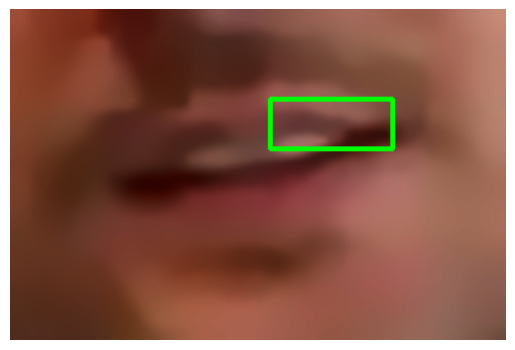

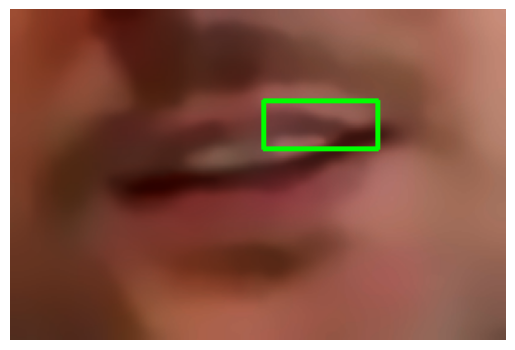

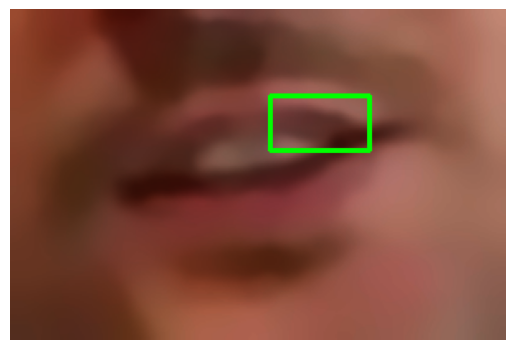

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt


# Path to the video file
video_path = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Datasets/Dataset_2_BABELE/BABELE_Dataset/Dataset_split_subject_independent/Lips_video_10_seconds_division_train_test_val/Test/1_1_1_11_30_1_m.avi"

#video_path = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Datasets/Dataset_2_BABELE/BABELE_Dataset/Dataset_split_subject_independent/Full_video_10_seconds_division_train_test_val/Test/1_1_1_11_30_1.avi"


# Create a VideoCapture object
cap = cv2.VideoCapture(video_path)
# Parameters for Lucas-Kanade optical flow
lk_params = dict(winSize=(15, 15),
                 maxLevel=2,
                 criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))

# Initialize previous frame and previous points
prev_frame = None
prev_points = None

while True:
    # Read frame from video
    ret, frame = cap.read()
    
    if not ret:
        break
    
    # Apply noise reduction
    frame = cv2.fastNlMeansDenoisingColored(frame, None, 10, 10, 7, 21)
    
    # Convert frame to grayscale
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    
    if prev_frame is None:
        prev_frame = gray
        prev_points = cv2.goodFeaturesToTrack(prev_frame, maxCorners=100, qualityLevel=0.3,
                                              minDistance=7, blockSize=7)
        continue
    
    # Calculate optical flow
    next_points, status, _ = cv2.calcOpticalFlowPyrLK(prev_frame, gray, prev_points, None, **lk_params)
    
    # Filter out points with low status
    good_points = next_points[status == 1]
    
    # Find the bounding box for the lip region
    x, y, w, h = cv2.boundingRect(good_points)
    
    # Draw bounding box on the frame
    cv2.rectangle(frame, (x, y), (x+w, y+h), (0, 255, 0), 2)
    
    # Convert BGR to RGB for displaying with Matplotlib
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    
    # Display the frame using Matplotlib
    plt.imshow(frame_rgb)
    plt.axis('off')
    plt.show()
    
    # Update previous frame and points
    prev_frame = gray.copy()
    prev_points = good_points.reshape(-1, 1, 2)
    
    # Exit if 'q' is pressed
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release the video capture and close all windows
cap.release()
cv2.destroyAllWindows()

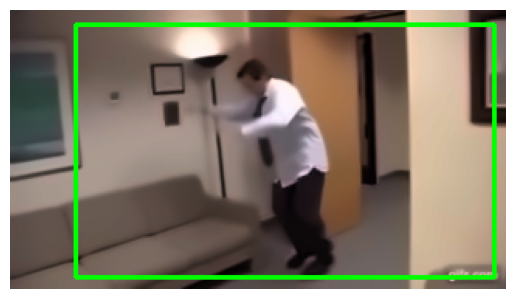

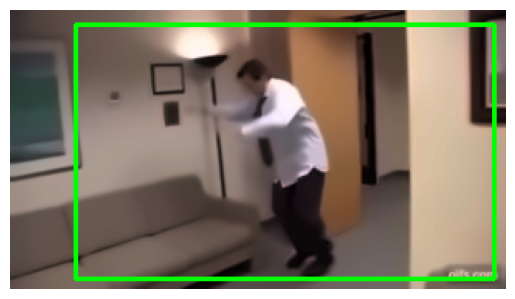

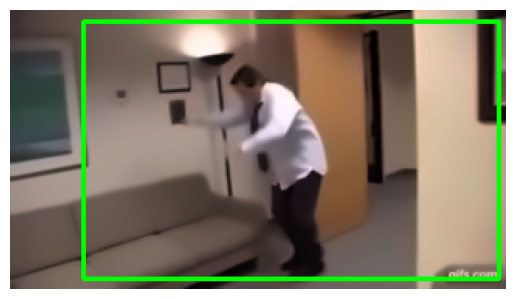

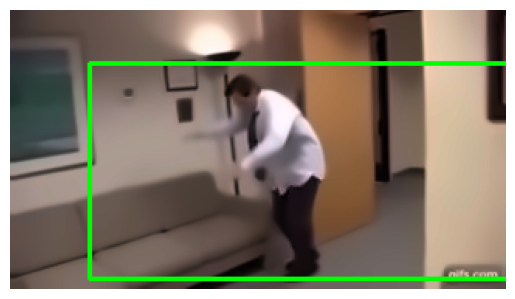

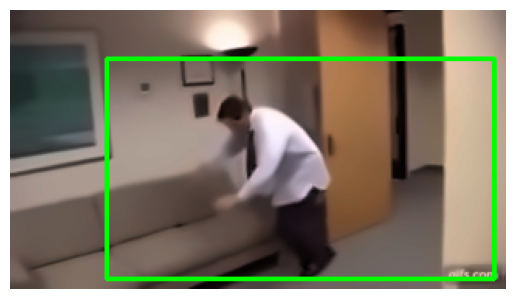

...

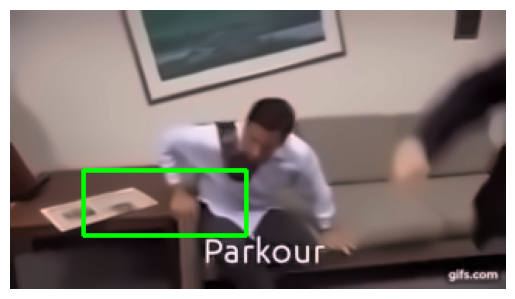

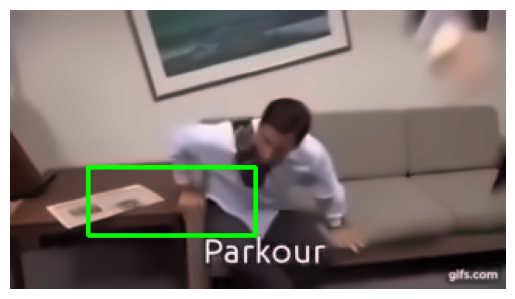

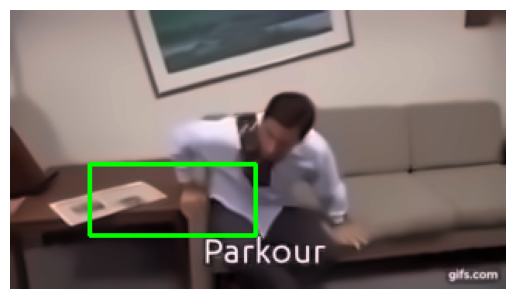

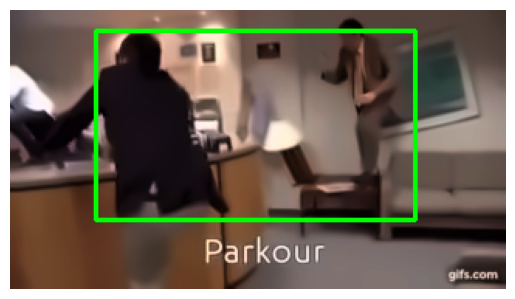

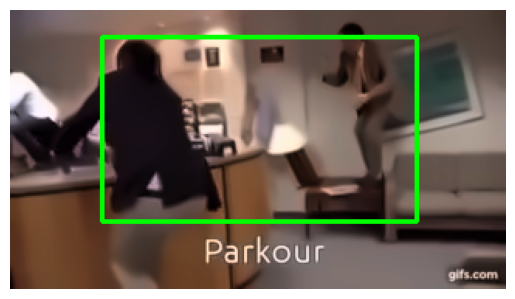

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt


# Path to the video file
#video_path = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Datasets/Dataset_2_BABELE/BABELE_Dataset/Dataset_split_subject_independent/Lips_video_10_seconds_division_train_test_val/Test/1_1_1_11_30_1_m.avi"

video_path = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Datasets/Dataset_2_BABELE/BABELE_Dataset/Dataset_split_subject_independent/Full_video_10_seconds_division_train_test_val/Test/1_1_1_11_30_1.avi"


# Create a VideoCapture object
cap = cv2.VideoCapture(video_path)
# Parameters for Lucas-Kanade optical flow
lk_params = dict(winSize=(15, 15),
                 maxLevel=2,
                 criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03))

# Initialize previous frame and previous points
prev_frame = None
prev_points = None

while True:
    # Read frame from video
    ret, frame = cap.read()
    
    if not ret:
        break
    
    # Apply noise reduction
    frame = cv2.fastNlMeansDenoisingColored(frame, None, 10, 10, 7, 21)
    
    # Convert frame to grayscale
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    
    if prev_frame is None:
        prev_frame = gray
        prev_points = cv2.goodFeaturesToTrack(prev_frame, maxCorners=100, qualityLevel=0.3,
                                              minDistance=7, blockSize=7)
        continue
    
    # Calculate optical flow
    next_points, status, _ = cv2.calcOpticalFlowPyrLK(prev_frame, gray, prev_points, None, **lk_params)
    
    # Filter out points with low status
    good_points = next_points[status == 1]
    
    # Find the bounding box for the lip region
    x, y, w, h = cv2.boundingRect(good_points)
    
    # Draw bounding box on the frame
    cv2.rectangle(frame, (x, y), (x+w, y+h), (0, 255, 0), 2)
    
    # Convert BGR to RGB for displaying with Matplotlib
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    
    # Display the frame using Matplotlib
    plt.imshow(frame_rgb)
    plt.axis('off')
    plt.show()
    
    # Update previous frame and points
    prev_frame = gray.copy()
    prev_points = good_points.reshape(-1, 1, 2)
    
    # Exit if 'q' is pressed
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release the video capture and close all windows
cap.release()
cv2.destroyAllWindows()

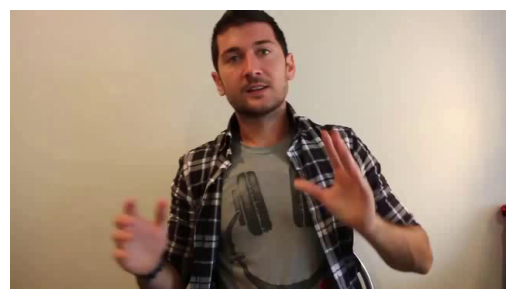

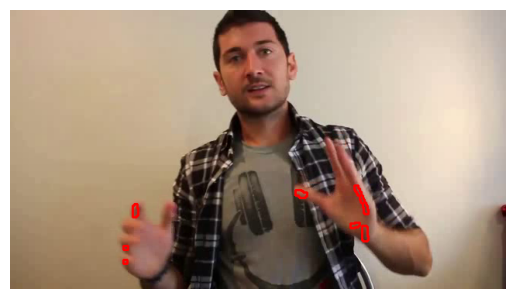

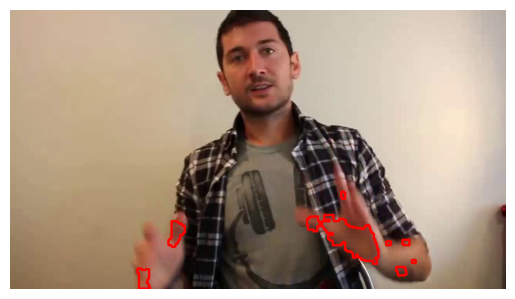

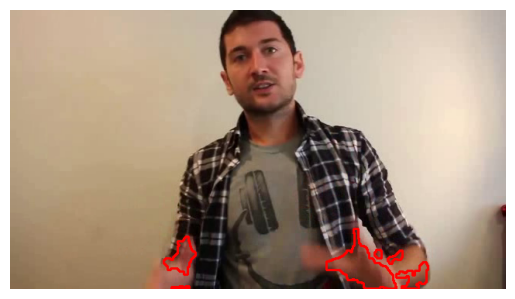

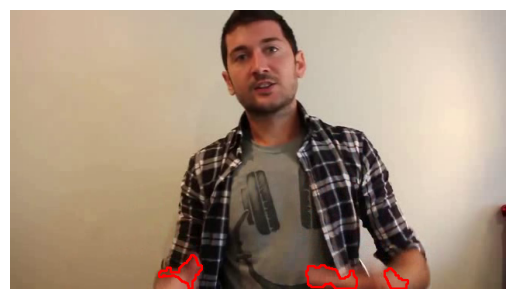

...

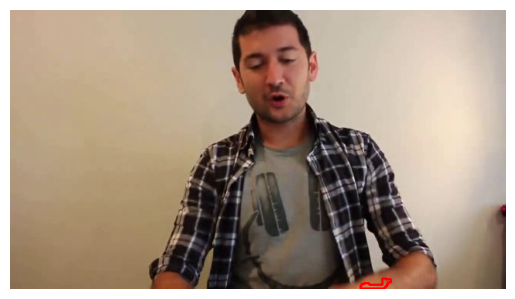

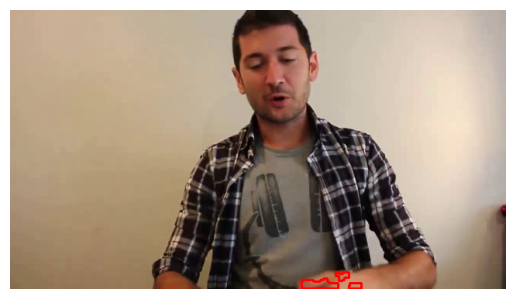

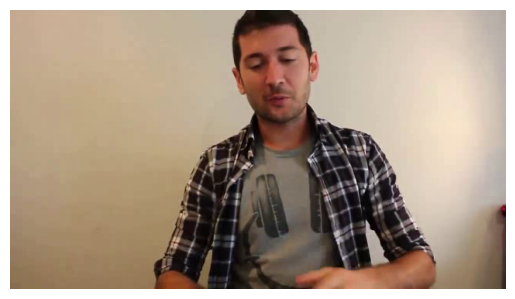

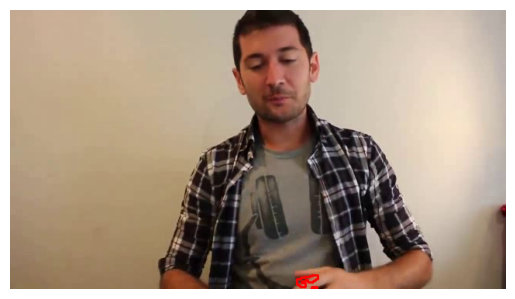

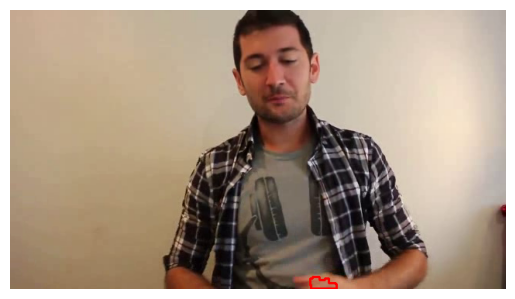

KeyboardInterrupt: ignored

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Path to the video file
video_path = "/content/drive/Shareddrives/Progetti FVAB 22 23 - VSR & BABELE/Datasets/Dataset_2_BABELE/BABELE_Dataset/Dataset_split_subject_independent/Full_video_10_seconds_division_train_test_val/Test/1_1_1_11_30_1.avi"


# Create a VideoCapture object
cap = cv2.VideoCapture(video_path)

# Initialize variables for optical flow
prev_frame = None
prev_gray = None

while True:
    # Read the current frame from the video
    ret, frame = cap.read()

    if not ret:
        break

    # Convert the frame to grayscale
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

    if prev_frame is not None:
        # Calculate optical flow between the previous and current frame
        flow = cv2.calcOpticalFlowFarneback(prev_gray, gray, None, 0.5, 3, 15, 3, 5, 1.2, 0)

        # Compute the magnitude and angle of the optical flow vectors
        magnitude, angle = cv2.cartToPolar(flow[..., 0], flow[..., 1])

        # Threshold the magnitude to extract strong optical flow regions (lips)
        threshold = 10  # Adjust this threshold based on your requirements
        lips_mask = cv2.threshold(magnitude, threshold, 255, cv2.THRESH_BINARY)[1]

        # Apply color segmentation to the lips mask
        hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
        lower_lip = np.array([0, 120, 70], dtype=np.uint8)
        upper_lip = np.array([10, 255, 255], dtype=np.uint8)
        lip_mask = cv2.inRange(hsv, lower_lip, upper_lip)

        # Combine the optical flow mask and color segmentation mask
        lips_mask = cv2.bitwise_and(lips_mask, lips_mask, mask=lip_mask)

        # Apply morphological operations to remove noise
        kernel = np.ones((5, 5), np.uint8)
        lips_mask = cv2.morphologyEx(lips_mask, cv2.MORPH_OPEN, kernel)

        # Convert the lips mask to the required format
        if cv2.__version__.startswith('4'):
            lips_mask = np.uint8(lips_mask)
        else:
            lips_mask = np.uint8(lips_mask) * 255

        # Find contours in the lips mask
        contours, _ = cv2.findContours(lips_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Draw the contours on the frame
        cv2.drawContours(frame, contours, -1, (0, 0, 255), 2)

    # Display the frame with the lip extraction
    plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

    # Update the previous frame and grayscale image
    prev_frame = frame
    prev_gray = gray

# Release the video capture
cap.release()